# Part A: GAN
***

## Background Research

The EMNIST dataset is a widely recognized benchmark for learning, classification, and computer vision systems. Its popularity is due to the task's simplicity and intuitiveness, the dataset's manageable size and storage requirements, and the database's accessibility and user-friendliness. The MNIST database originated from the larger NIST Special Database 19, which includes handwritten digits, as well as uppercase and lowercase letters. This task uses a variant of the complete NIST dataset, named Extended MNIST (EMNIST), which was created using the same conversion methods as the original MNIST dataset. EMNIST offers a more challenging classification task that involves letters while maintaining the same image structure and parameters as MNIST. This ensures direct compatibility with existing classifiers and systems.
***

## Setting up everything
***

### Importing the neccessary libraries
***

In [1]:
# Helper Libraries
import numpy as np
import matplotlib.pyplot as plt
import os
import tensorflow as tf
import pandas as pd

# For EDA
from sklearn.manifold import TSNE

# For Preprocessing
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import resample

# For Model Training/Improvment
from keras import Sequential, Model
from keras.layers import Dense, Conv2D, Reshape, UpSampling2D, BatchNormalization, Activation, Input, LeakyReLU, ZeroPadding2D, Dropout, Flatten, Conv2DTranspose, Embedding, Concatenate
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.optimizers import RMSprop, Adam
from tensorflow.keras import backend as K
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from scipy.linalg import sqrtm
from tensorflow.image import resize
from scipy.special import kl_div
from skimage.transform import resize


In [2]:
# For the Images GIF for the "eye power" evaluation
import os
import imageio
from IPython.display import display, Image

def create_gif(image_folder, output_path, duration=0.5):
    # Get all image file names in the directory
    images = [img for img in os.listdir(image_folder) if img.endswith(".png")]
    images.sort(key=lambda x: int(x.split('_')[-1].split('.')[0]))  # Sort images by epoch number

    # Read images and append to list
    frames = []
    for image in images:
        img_path = os.path.join(image_folder, image)
        frames.append(imageio.imread(img_path))

    # Create and save the GIF
    imageio.mimsave(output_path, frames, duration=duration)
    print(f"GIF saved at {output_path}")

### Loading the required dataset
***

In [5]:
# Loading the dataset
data = pd.read_csv('emnist-letters-train.csv', header = None)

## EDA
***

### View the first 5 rows of the dataset

In [4]:
data.head()

,0,1,2,3,4,5,6,7,8,9,...,775,776,777,778,779,780,781,782,783,784
0,23,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,7,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,16,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,15,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,23,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


***
From above, we can see that there is 785 columns and 5 rows in the dataset.

Each row represents a image. The 1st column represents the labels. The 2nd to 784th column represents the image data.

**1st column:** The emnist-letters dataset is made up of alphabets from letter A to letter Z. Each letter is assigned to an alphabet, example, letter A is assigned to 1, letter B is assigned to 2, etc.

**2nd to 784th column:** To store the images easily, the images are flattened from a 28x28 to a 784 vector where each column holds a part of the image data. 

Before using the images for GAN machine learning later on, we would need to convert the 784 vector image data back into a 28x28 image.
***

### View the shape of the image and label

In [6]:
# Image data
X = data.iloc[:, 1:].values
# Label data
y = data.iloc[:, 0].values

# Show the shape of the Image Data
print(f"Images shape: {X.shape}")

# Show the shape of the Label Data
print(f"Labels shape: {y.shape}")

Images shape: (99040, 784)
Labels shape: (99040,)


***
From above, we can see that the images are indeed currently in the 784 vector which we would be converting back to a 28x28 later on.
***

### Reshape the image data into the required dimensions (Preprocessing)

In [7]:
# Reshape Image Data into the required dimensions
X = X.reshape(99040, 28, 28)

# Show the shape of the Image Data
print(f"Images shape: {X.shape}")

Images shape: (99040, 28, 28)


***
This is a preprocessing step. From above, we have converted the images back into 28x28 to be used.
***

### Viewing 10 images from each class 

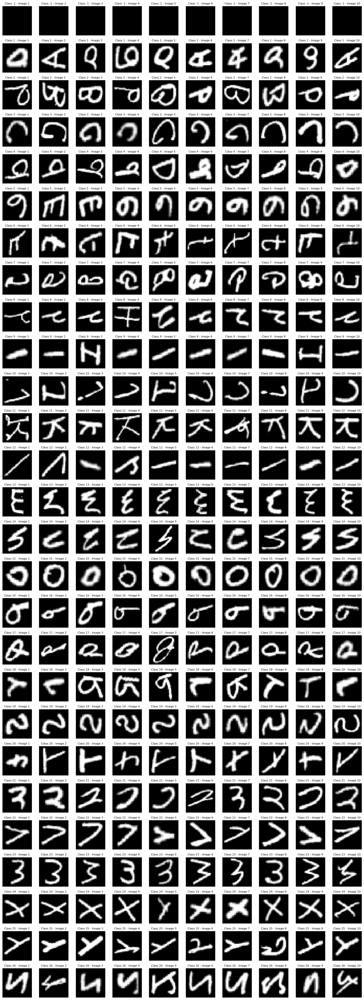

In [8]:
# Create a dictionary to store 10 random images per class
class_images = {}
unique_labels = np.unique(y)

# Number of images per class to display
num_images_per_class = 10

for label in unique_labels:
    # Get all images of the current label
    label_indices = np.where(y == label)[0]
    # Select 10 random indices from the label indices
    random_indices = np.random.choice(label_indices, size=num_images_per_class, replace=False)
    # Store the random images for the current label
    class_images[label] = X[random_indices]

# Number of classes and images
num_classes = len(class_images)
num_images = num_images_per_class * num_classes
num_columns = num_images_per_class  # Each class will have num_images_per_class images in one row
num_rows = num_classes  # Each class will be represented in one row

# Create the subplots
fig, ax = plt.subplots(num_rows, num_columns, figsize=(15, 1.5 * num_rows))

# Plot each image
for i, label in enumerate(unique_labels):
    for j in range(num_images_per_class):
        ax[i, j].imshow(class_images[label][j].reshape(28, 28), cmap='gray')
        ax[i, j].set_title(f"Class {label} - Image {j + 1}", fontsize=8)  # Adjust fontsize as needed
        ax[i, j].axis('off')

plt.tight_layout()
plt.show()

***
From above, we can see that are 27 classes. 

There is class -1 which is blank and does not contain any useful features or contribute to an alphabet for machine learning. Therefore later on in preprocessing, we have to exclude class -1 from the training dataset to make it so that the neural network can train on proper data.

We can also observe that images are not in the correct orientation. We will be transposing the images to the correct orientation so that it would be easier for us to visualize and for the machine to learn properly.

We can also observe that the classes is a mix of upper case and lower case letters which could affect how the machine learns as certain letters such as "a" and "A" would look differently, affecting the ability of the machine to learn. However, as each image is already assigned a label, the machine is able to learn on both sets of lower case letters and upper case letters.
***

### Transposing the images (Preprocessing)

Images shape: (99040, 28, 28)


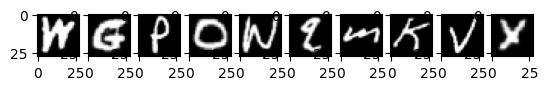

In [8]:
# Transposing the image by 90 degress anticlockwise
X = X.transpose(0,2,1)

# Show the shape of the Image Data
print(f"Images shape: {X.shape}")

fig, ax = plt.subplots(1,10)
for i in range(10):
        ax[i].imshow(X[i], cmap='gray')

***
This is a preprocessing step. From above, we have swapped the width and height of the images, effectively changing the orientation of the images. This allows the machine to be trained on the correct orientation of the dataset.
***

### Average image

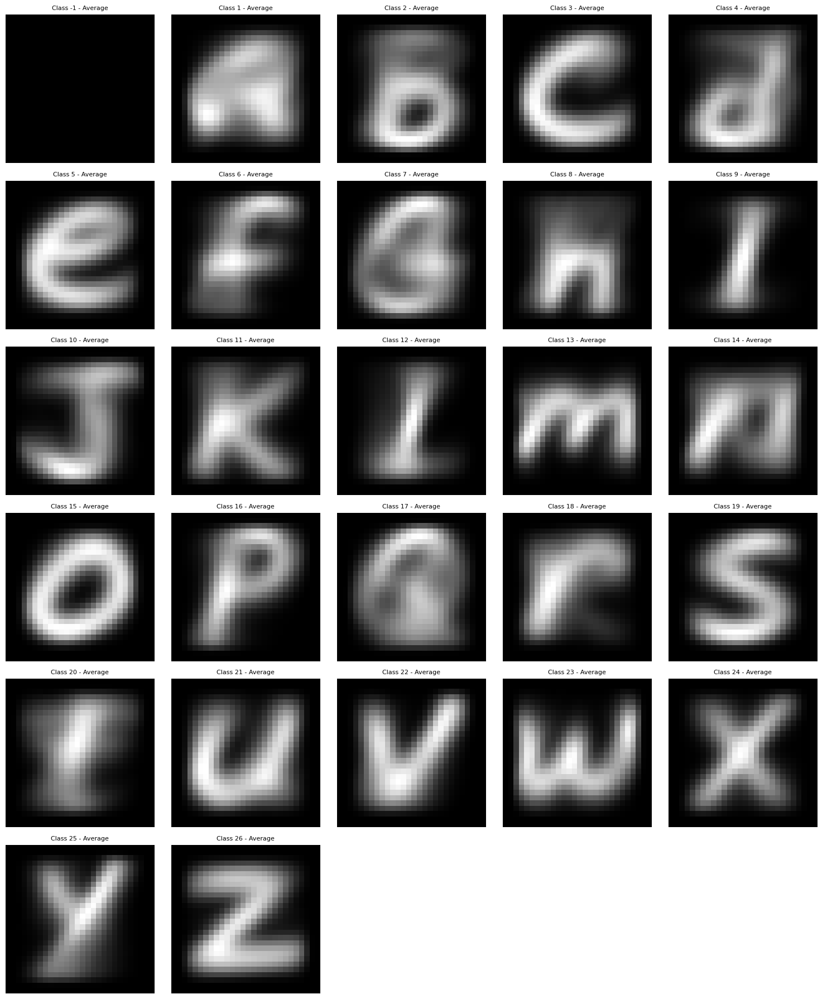

In [9]:
# Create a dictionary to store the average image per class
average_images = {}
unique_labels = np.unique(y)

# Compute the average image for each class
for label in unique_labels:
    # Get all images of the current label
    label_indices = np.where(y == label)[0]
    # Compute the average image
    average_image = np.mean(X[label_indices], axis=0)
    # Store the average image for the current label
    average_images[label] = average_image

# Number of classes
num_classes = len(average_images)
images_per_row = 5
num_rows = (num_classes + images_per_row - 1) // images_per_row  # Ceiling division

# Create the subplots
fig, ax = plt.subplots(num_rows, images_per_row, figsize=(15, 3 * num_rows))

# Flatten the axes array for easier indexing
ax = ax.flatten()

# Plot each average image
for i, label in enumerate(unique_labels):
    ax[i].imshow(average_images[label].reshape(28, 28), cmap='gray')
    ax[i].set_title(f"Class {label} - Average", fontsize=8)  # Adjust fontsize as needed
    ax[i].axis('off')

# Hide any unused subplots
for i in range(len(unique_labels), len(ax)):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

***
From above, we have found the average image by taking the average value of each pixels across all images in every class. This allow us to visualize and highlight the details among different classes.​

- **What is it about**
    - Images are generated by computing the pixel-wise average of a collection of images within a specific category or class.

- **Why do we use it for the EMNIST Dataset:**
    - Detecting Common Features: 
        - Averaging images of the same class (e.g., all 'A's or all 'B's) can highlight the common features and patterns within that class. This can be useful to understand what the "typical" character of each class looks like.
    - Identifying Noise and Variability: 
        - If the average image of a particular class is blurry, it indicates high variability in how that character is written. Conversely, a sharp average image suggests low variability.
    - Quality Check: 
        - Average images can help identify issues with the dataset. For instance, if the average image of the letter looks strange, it might indicate mislabeled data or inclusion of unwanted images.

We can see that class -1 is a class where images are just blank or have no image. Since there is no useful features from the class, we would be dropping the class from the dataset for training.
***

### Dropping class -1 from the dataset (Preprocessing)

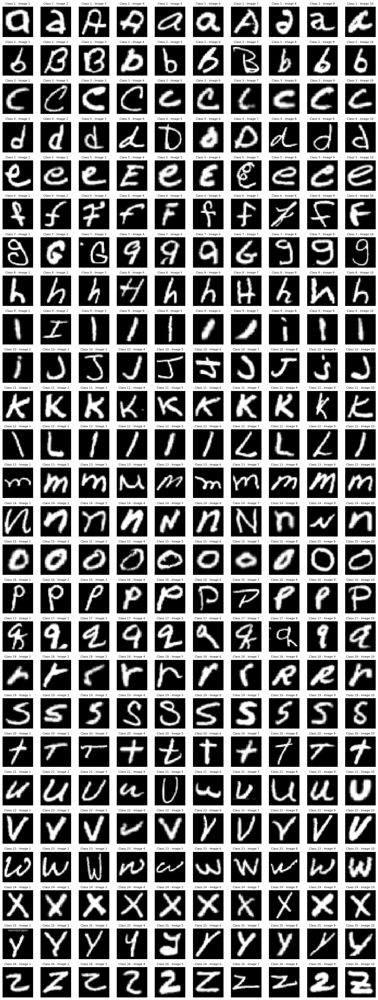

In [9]:
# Exclude class -1
valid_indices = y != -1
X = X[valid_indices]
y = y[valid_indices]

# Create a dictionary to store 10 random images per class
class_images = {}
unique_labels = np.unique(y)

# Number of images per class to display
num_images_per_class = 10

for label in unique_labels:
    # Get all images of the current label
    label_indices = np.where(y == label)[0]
    # Select 10 random indices from the label indices
    random_indices = np.random.choice(label_indices, size=num_images_per_class, replace=False)
    # Store the random images for the current label
    class_images[label] = X[random_indices]

# Number of classes and images
num_classes = len(class_images)
num_images = num_images_per_class * num_classes
num_columns = num_images_per_class  # Each class will have num_images_per_class images in one row
num_rows = num_classes  # Each class will be represented in one row

# Create the subplots
fig, ax = plt.subplots(num_rows, num_columns, figsize=(15, 1.5 * num_rows))

# Plot each image
for i, label in enumerate(unique_labels):
    for j in range(num_images_per_class):
        ax[i, j].imshow(class_images[label][j].reshape(28, 28), cmap='gray')
        ax[i, j].set_title(f"Class {label} - Image {j + 1}", fontsize=8)  # Adjust fontsize as needed
        ax[i, j].axis('off')

plt.tight_layout()
plt.show()

***
This is a preprocessing step. From above, we have excluded class -1 from the dataset. This allows the machine to be trained on the more useful classes of the dataset, as shown in previous steps class -1 is a completely empty image with no useful features.
***

### Contrastive image

C:\Users\caleb\AppData\Local\Temp\ipykernel_12944\7717810.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


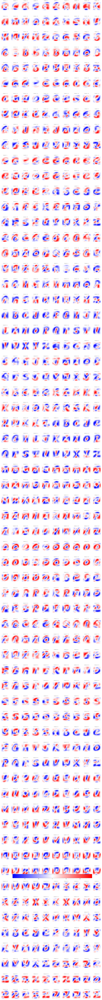

In [16]:
# Dictionary to store the average image per class
average_images = {}
unique_labels = np.unique(y)

# Compute the average image for each class
for label in unique_labels:
    # Get all images of the current label
    label_indices = np.where(y == label)[0]
    # Compute the average image
    average_image = np.mean(X[label_indices], axis=0)
    # Store the average image for the current label
    average_images[label] = average_image

# Compute the contrastive images
contrastive_images = {}
for i, label1 in enumerate(unique_labels):
    for j, label2 in enumerate(unique_labels):
        if label1 != label2:
            contrastive_image = average_images[label1] - average_images[label2]
            contrastive_images[(label1, label2)] = contrastive_image

# Number of contrastive images
num_contrastive = len(contrastive_images)
images_per_row = 10
num_rows = (num_contrastive + images_per_row - 1) // images_per_row  # Ceiling division

# Create the subplots
fig, ax = plt.subplots(num_rows, images_per_row, figsize=(20, 3 * num_rows))

# Flatten the axes array for easier indexing
ax = ax.flatten()

# Plot each contrastive image
for i, ((label1, label2), contrastive_image) in enumerate(contrastive_images.items()):
    im = ax[i].imshow(contrastive_image.reshape(28, 28), cmap='bwr', vmin=-np.max(np.abs(contrastive_image)), vmax=np.max(np.abs(contrastive_image)))
    ax[i].set_title(f"Contrast: {label1} - {label2}", fontsize=8)  # Adjust fontsize as needed
    ax[i].axis('off')

# Hide any unused subplots
for i in range(len(contrastive_images), len(ax)):
    ax[i].axis('off')

# Add a colorbar
fig.colorbar(im, ax=ax, orientation='horizontal', fraction=0.02, pad=0.04)

plt.tight_layout()
plt.show()

***
Using the average images, we can further compute the contrastive image between different classes.

- **What is it about:** 
    - Contrastive images refer to comparing images from different classes or different subsets of data to highlight and analyze differences. For instance, you might compare images of the same letter from different sources or styles to understand variability within the class.
- **Why do we use it for EMNIST Dataset:**
    - Analyzing Variability:
        - By comparing contrastive images, you can analyze how different images within the same class vary. This helps in understanding the range of variability and common features within the class.
    - Insight into Variability: 
        - Helps to understand the variability within different classes of EMNIST, which can be useful for feature extraction and model improvement.
    - Class Separation: 
        - Can provide insights into how well different classes are separated or how they overlap, which is useful for tasks like classification and clustering. 
    - Identifying Differences: 
        - Contrastive images can be used to identify key differences between classes. For example, comparing images of '5' and '6' can help to understand the features that distinguish these two digits.      
***

### T-SNE

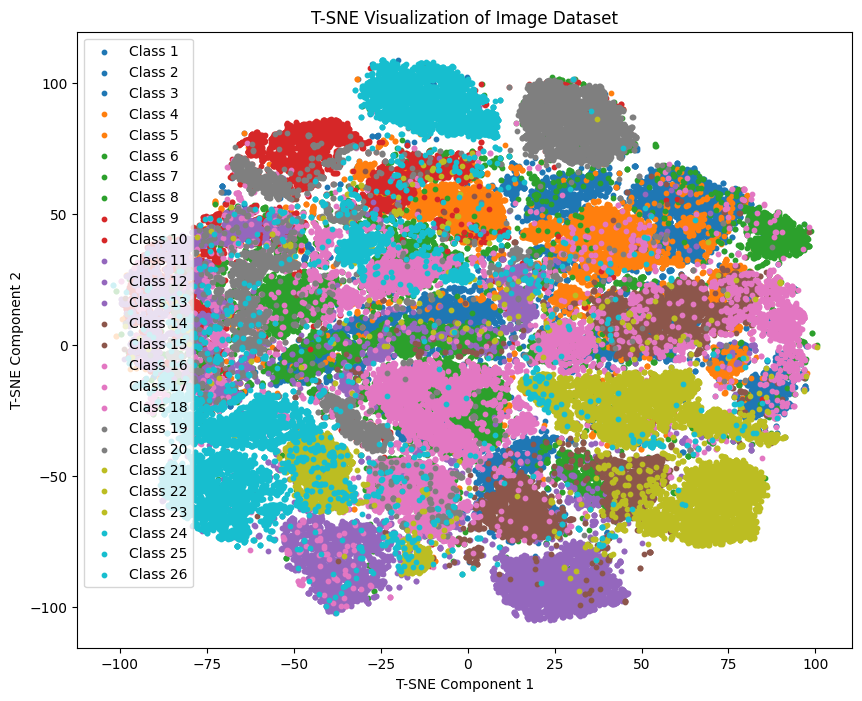

In [17]:
# Flatten each image in X to 1D array
X_flat = X.reshape(X.shape[0], -1)  # Flatten each image into a 1D array

# Perform T-SNE dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_flat)

# Plotting the 2D embedding
plt.figure(figsize=(10, 8))

# Get unique classes
unique_classes = np.unique(y)

# Assign a color to each class
colors = plt.cm.tab10(np.linspace(0, 1, len(unique_classes)))

# Plot each class with its own color
for i, class_label in enumerate(unique_classes):
    plt.scatter(X_tsne[y == class_label, 0], X_tsne[y == class_label, 1], color=colors[i], label=f'Class {class_label}', s=10)

plt.title('T-SNE Visualization of Image Dataset')
plt.xlabel('T-SNE Component 1')
plt.ylabel('T-SNE Component 2')
plt.legend()
plt.show()

***
From above, we can see the T-SNE visualization of the different classes in the dataset.

- **What is it about:** 
    - t-SNE is a non-linear dimensionality reduction technique specifically designed for the visualization of high-dimensional datasets. It reduces the dimensions of the data while preserving the structure and relationships between data points. t-SNE is particularly effective for visualizing data in two or three dimensions.
- **Why do we use it for EMNIST Dataset:**
    - High-Dimensional Data: 
        - EMNIST images are high-dimensional (28x28 pixels, resulting in 784-dimensional vectors). Visualizing this high-dimensional data directly is challenging, and t-SNE helps reduce these dimensions to 2D or 3D for easier visualization.
    - Cluster Visualization: 
        - t-SNE can reveal the natural clusters in the data. For instance, letters of the same class should ideally cluster together. This can help in understanding the distribution of different characters.   
    - Anomaly Detection: 
        - Outliers or mislabeled data can be detected through t-SNE plots, as these points will often appear isolated from the main clusters.     
***

### View the number of images in each class

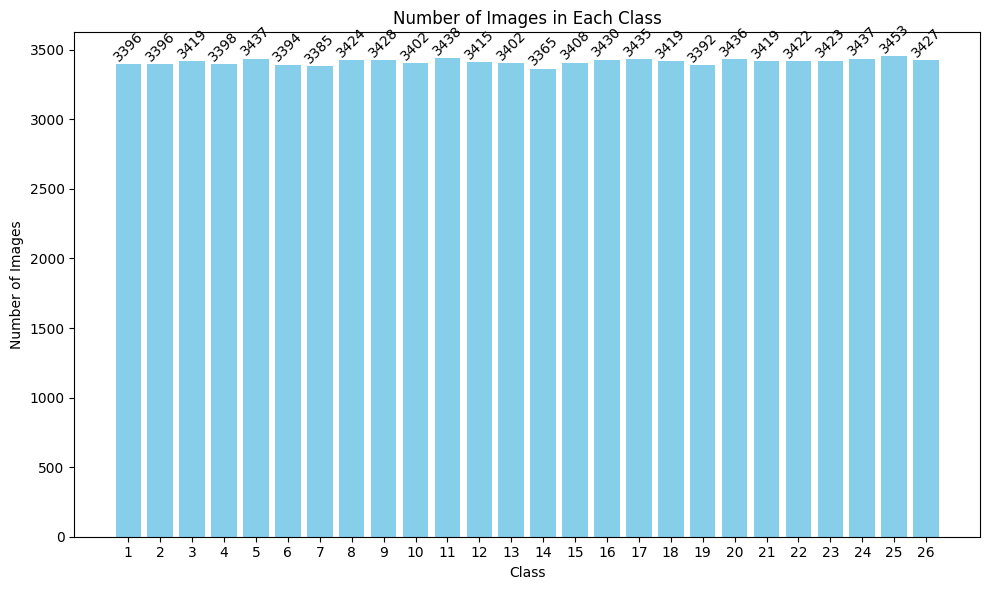

In [25]:
# Count the number of images in each class
class_counts = np.unique(y, return_counts=True)

# Plot the number of images in each class
plt.figure(figsize=(10, 6))
bars = plt.bar(class_counts[0], class_counts[1], color='skyblue')
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Number of Images in Each Class')
plt.xticks(class_counts[0])

# Add the count labels on top of each bar with diagonal rotation
for bar, count in zip(bars, class_counts[1]):
    plt.text(bar.get_x() + bar.get_width() / 2.0, bar.get_height(), str(count),
             ha='center', va='bottom', rotation=45)

plt.tight_layout()
plt.show()

***
From above, we can see that there are different numbers of images in each class. 

The largest class 25 (Y) has 3453 images while the smallest class 14 (N) has 3365 images.

We would fix this in preprocessing.
***

## Preprocessing
***

### Oversampling to balance the imbalanced classes

Balanced Images shape: (89778, 28, 28)
Balanced Labels shape: (89778,)


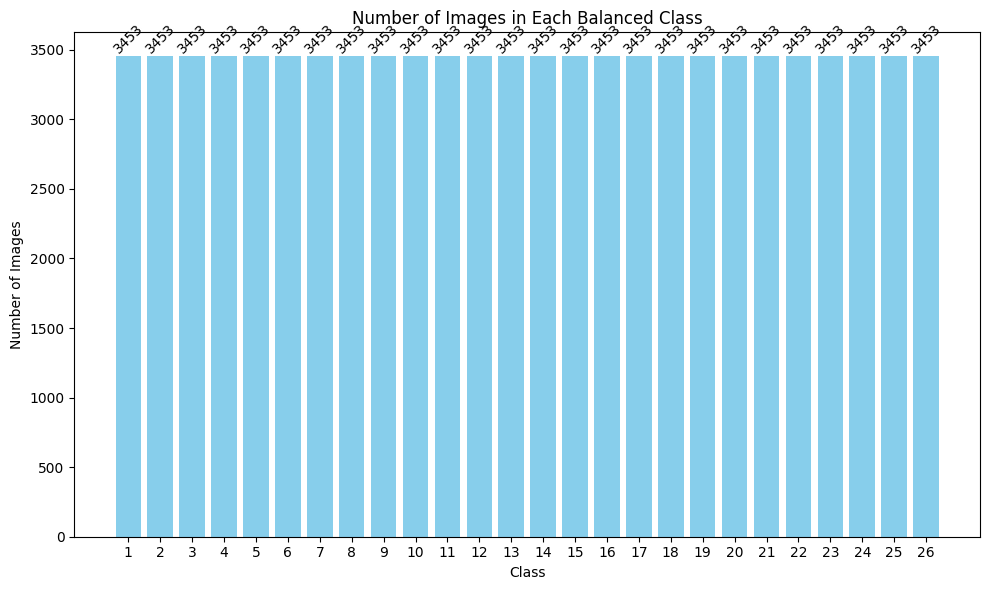

In [10]:
# Count the number of images in each class
class_counts = np.unique(y, return_counts=True)

# Find the maximum count among all classes
max_count = np.max(class_counts[1])

# Balanced dataset
balanced_X = []
balanced_y = []

for label in class_counts[0]:
    # Get all images of the current label
    label_indices = np.where(y == label)[0]
    # Resample images to match the maximum count
    resampled_indices = resample(label_indices, replace=True, n_samples=max_count, random_state=42)
    balanced_X.append(X[resampled_indices])
    balanced_y.append(y[resampled_indices])

# Concatenate the balanced datasets
balanced_X = np.concatenate(balanced_X)
balanced_y = np.concatenate(balanced_y)

# Show the shape of the balanced Image Data and Label Data
print(f"Balanced Images shape: {balanced_X.shape}")
print(f"Balanced Labels shape: {balanced_y.shape}")

# Verify the balancing
balanced_class_counts = np.unique(balanced_y, return_counts=True)

# Plot the number of images in each balanced class
plt.figure(figsize=(10, 6))
bars = plt.bar(balanced_class_counts[0], balanced_class_counts[1], color='skyblue')
plt.xlabel('Class')
plt.ylabel('Number of Images')
plt.title('Number of Images in Each Balanced Class')
plt.xticks(balanced_class_counts[0])

# Add the count labels on top of each bar with diagonal rotation
for bar, count in zip(bars, balanced_class_counts[1]):
    plt.text(bar.get_x() + bar.get_width() / 2.0, bar.get_height(), str(count),
             ha='center', va='bottom', rotation=45)

plt.tight_layout()
plt.show()

***
There are several ways that are able to be used to balance the number of images in each class:

- Undersampling:
    - Undersampling would not be suitable in this scenario because it involves reducing the number of instances in the majority class to match the minority class. This approach could potentially discard valuable data and lead to loss of information, especially if the dataset is not excessively large. 
- Oversampling:
    - Oversampling involves increasing the number of instances in the minority class to match the majority class.
    - In this case, since the smallest class has 3365 images and the largest class has 3453 images, we would increase the number of samples in the smallest class to match the largest class. This can be done using techniques like SMOTE (Synthetic Minority Over-sampling Technique) or simply duplicating existing samples until all classes have an equal number of samples.
- Data Augmentation:
    - Data augmentation involves creating new training examples by perturbing existing data through transformations like rotation, scaling, flipping, etc
    - While typically used to artificially increase the size of a dataset, it can also be used to balance class distributions by generating new samples for minority classes until all classes have an equal number of samples.


In the end, we have chosen with OverSampling due to several reasons:
- Keeps all the original data intact and augments the minority classes to match the majority class size.
- Can help improve model performance by providing more balanced training data without losing any information.
- However, we must be careful as it can lead to overfitting. This is because the model might see the same minority class samples multiple times.
***

### Normalization

Normalized Images shape: (89778, 28, 28)


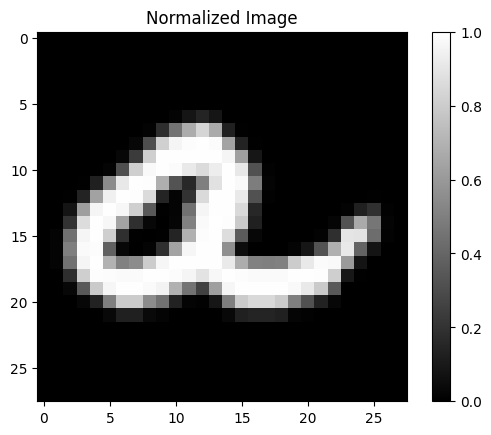

In [11]:
# Normalize the balanced dataset
balanced_X = balanced_X / 255.0

# Verify the new shape and normalization
print(f"Normalized Images shape: {balanced_X.shape}")

# Example: Show the first image after normalization
plt.figure()
plt.imshow(balanced_X[0], cmap='gray')
plt.colorbar()
plt.title('Normalized Image')
plt.show()

***
From above, we have done normalization. I have decided to do normalization due to several reasons:
- Stable Training: 
    - GANs, especially, can be challenging to train because they involve two networks (the generator and the discriminator) that are trained simultaneously. Normalizing input data helps stabilize the training process by providing a consistent scale for the inputs.
- Gradient Descent Efficiency: 
    - Normalization ensures that the gradients used for updating the weights are within a reasonable range, preventing issues like exploding or vanishing gradients which can hinder the training of both the generator and discriminator.
- Balanced Learning: 
    - By normalizing the data, each feature contributes equally to the learning process. This is particularly important in image data where each pixel should have an equal opportunity to influence the model's learning.
- Mitigates Dominance: 
    - Without normalization, features with larger scales (e.g., high pixel values) can dominate the learning process, leading to suboptimal training.
***

## Model Training
***

### Choice of metrics
 
**D loss:**
- Quantifies how well the discriminator is able to distinguish between real and fake handwritten characters. It is a measure of the performance of the discriminator network.
- The discriminator loss helps in training the discriminator to effectively differentiate between real handwritten characters and those generated by the generator. A well-calibrated discriminator loss is crucial for the GAN to produce realistic handwritten characters.
- Significance:
    - Smaller Values: Discriminator is **effectively** distinguishing between real and fake handwritten characters.
    - Larger Values: Discriminator is **struggling** to differentiate between real and fake handwritten characters.

**G loss:**
- Measures how well the generator is performing by evaluating how well it can fool the discriminator into classifying fake handwritten characters as real.
- Helps in training the generator to produce high-quality and realistic handwritten characters. By minimizing this loss, the generator learns to create handwritten characters that are increasingly difficult for the discriminator to distinguish from real ones.
- Significance:
    - Smaller Values: Indicate that the generator is **effectively** fooling the discriminator which is the goal.
    - Larger Values: Suggest that the generator is **not successfully** fooling the discriminator.

**D accuracy:**
- Measures how accurately the discriminator classifies real and fake handwritten characters.
- Provides insight into the performance of the discriminator on the EMNIST dataset, indicating how well it differentiates between real and generated handwritten characters.
- Significance:
    - Larger Values: Indicate that the discriminator is **accurately** classifying real and fake handwritten characters.
    - Smaller Values: Suggest that the discriminator is **not performing well**, either because it is not distinguishing real from fake handwritten characters effectively or because the generator has become very effective at creating realistic handwritten characters.

**D KL divergence:**
- Measure how the discriminator’s predictions (probability distributions) deviate from the true labels (real vs. fake).
- Significance:
    - Smaller Values: Discriminator is accurately classifying real vs. fake handwritten characters. 

**G KL divergence:**
- Measure how the distribution of generated images deviates from the true data distribution.
- Access how well the generator’s outputs match the real data distribution of handwritten characters and how the discriminator’s probability distributions align with true labels.
- Significance:
    - Smaller Values: Generator is producing characters that closely match the real characters in the dataset.
    .

**FID Score:**
- Measures the quality of generated images by comparing the distribution of generated handwritten characters to the distribution of real handwritten characters. It uses features extracted by a pre-trained Inception network.
- Provides a quantitative measure of how realistic the generated handwritten characters are compared to real ones. Lower FID scores indicate better quality of generated handwritten characters.
- Significance:
    - Smaller Values: Indicate **better quality** of generated handwritten characters. A lower FID score means that the generated handwritten characters are more similar to the real handwritten characters in terms of their feature distributions, which implies higher quality.
    - Larger Values: Suggest **worse quality** of generated handwritten characters. Higher FID scores mean that the generated handwritten characters are less similar to the real handwritten characters, indicating poorer performance of the generator.

**TLDR**
- Discriminator Loss (D Loss): 
    - **Smaller values** are generally better, indicating effective differentiation. However, if too small, the generator may need improvement.
- Generator Loss (G Loss):
    - **Smaller values** are better, as they indicate that the generator is successfully creating realistic handwritten characters.
- Discriminator Accuracy (D Accuracy): 
    - **Larger values** are better, showing that the discriminator is effectively distinguishing between real and generated characters.
- KL Divergence (Kullback-Leibler Divergence): 
    - **Smaller values** are better, indicating that the generated characters’ distribution is close to the real characters’ distribution.
- FID Score (Fréchet Inception Distance): 
    - **Smaller values** are better, indicating that the generated handwritten characters are of higher quality and closely resemble real characters.
***

### DCGAN Model

DCGAN (Deep Convolutional Generative Adversarial Network) is a type of Generative Adversarial Network (GAN) that uses deep convolutional networks in both the generator and discriminator.

**Why did we choose to train this model:**
- Image Generation: 
    - DCGANs can generate high-quality images, which is beneficial if you want to generate more samples of handwritten characters or digits.
- High Resolution: 
    - DCGANs are capable of producing reasonably high-resolution images, which can be useful if you need detailed character images.
- Versatility: 
    - Since EMNIST includes various types of handwritten characters, DCGANs can help explore different classes by generating samples for each class.
- Training Stability:
    - The architecture improvements of DCGANs, such as using batch normalization and ReLU activations, help stabilize training and improve convergence compared to other GAN models. 

**Weaknesses:**
- Lack of Control over Output:
    - DCGANs in their original form do not incorporate labels directly into the generation process. They also do not provide an easy way to control the attributes of the generated images, making it difficult to generate images with specific desired characteristics. This limitation can be problematic when there's a need to generate images with certain features or conditions, such as specific class of handwritten characters which we will encounter later on.  
    

In [78]:
# Define KL divergence metric
def kl_divergence(y_true, y_pred):
    y_true = K.clip(y_true, K.epsilon(), 1)
    y_pred = K.clip(y_pred, K.epsilon(), 1)
    return K.sum(y_true * K.log(y_true / y_pred), axis=-1)

class DCGAN:
    def __init__(self, rows, cols, channels, z=100):
        self.img_rows = rows
        self.img_cols = cols
        self.channels = channels
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = z

        optimizer = Adam(learning_rate=0.0002, beta_1=0.5)

        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy', kl_divergence])

        self.generator = self.build_generator()

        z = Input(shape=(self.latent_dim,))
        img = self.generator(z)

        self.discriminator.trainable = False
        valid = self.discriminator(img)

        self.combined = Model(z, valid)
        self.combined.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=[kl_divergence])

    def build_generator(self):
        model = Sequential(name='Generator')
        model.add(Dense(128 * 7 * 7, activation="relu", input_dim=self.latent_dim))
        model.add(Reshape((7, 7, 128)))
        model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2D(self.channels, kernel_size=7, padding="same", activation='sigmoid'))

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)
        return Model(noise, img)

    def build_discriminator(self):
        model = Sequential(name='Discriminator')
        model.add(Conv2D(128, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Flatten())
        model.add(Dense(1, activation='sigmoid'))

        model.summary()

        img = Input(shape=self.img_shape)
        validity = model(img)
        return Model(img, validity)

    def calculate_fid(self, real_images, generated_images):
        real_images_resized = np.array([resize(img, (75, 75, self.channels), anti_aliasing=True) for img in real_images])
        generated_images_resized = np.array([resize(img, (75, 75, self.channels), anti_aliasing=True) for img in generated_images])

        if self.channels == 1:
            real_images_rgb = np.concatenate([real_images_resized] * 3, axis=-1)
            generated_images_rgb = np.concatenate([generated_images_resized] * 3, axis=-1)
        else:
            real_images_rgb = real_images_resized
            generated_images_rgb = generated_images_resized

        model = InceptionV3(include_top=False, pooling='avg', input_shape=(75, 75, 3))
        
        real_images_rgb = preprocess_input(real_images_rgb)
        generated_images_rgb = preprocess_input(generated_images_rgb)
        
        real_activations = model.predict(real_images_rgb)
        generated_activations = model.predict(generated_images_rgb)

        mu_real, sigma_real = real_activations.mean(axis=0), np.cov(real_activations, rowvar=False)
        mu_gen, sigma_gen = generated_activations.mean(axis=0), np.cov(generated_activations, rowvar=False)

        ssdiff = np.sum((mu_real - mu_gen) ** 2.0)
        sqrt_sigma = sqrtm(sigma_real.dot(sigma_gen))
        if np.iscomplexobj(sqrt_sigma):
            sqrt_sigma = sqrt_sigma.real
        fid = ssdiff + np.trace(sigma_real + sigma_gen - 2.0 * sqrt_sigma)

        return fid

    def train(self, balanced_X, epochs, batch_size=128, save_interval=50):
        X_train = balanced_X

        X_train = X_train.reshape(-1, self.img_rows, self.img_cols, self.channels)

        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))

        d_losses = []
        g_losses = []
        d_accuracies = []
        kl_divergences_d = []
        kl_divergences_g = []
        fid_scores = []

        for epoch in range(epochs):
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]

            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.generator.predict(noise)

            d_loss_real = self.discriminator.train_on_batch(imgs, valid)
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            g_loss = self.combined.train_on_batch(noise, valid)

            if epoch % save_interval == 0:
                fid_score = self.calculate_fid(imgs, gen_imgs)
                fid_scores.append(fid_score)

            print("%d [D loss: %f, acc.: %.2f%%, KL div.: %f] [G loss: %f, KL div.: %f, FID: %f]" % (
                epoch, d_loss[0], 100 * d_loss[1], d_loss[2], g_loss[0], g_loss[1], fid_score if epoch % save_interval == 0 else 0))

            if epoch % save_interval == 0:
                self.save_imgs(epoch)
                d_losses.append(d_loss[0])
                g_losses.append(g_loss[0])
                d_accuracies.append(100 * d_loss[1])
                kl_divergences_d.append(d_loss[2])
                kl_divergences_g.append(g_loss[1])

        self.print_final_metrics(d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores)
        self.plot_losses(d_losses, g_losses, save_interval)
        self.plot_accuracy(d_accuracies, save_interval)
        self.plot_kl_divergence(kl_divergences_d, kl_divergences_g, save_interval)
        self.plot_fid(fid_scores, save_interval)

    def save_imgs(self, epoch):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.generator.predict(noise)
        
        gen_imgs_resized = np.array([resize(img, (75, 75, self.channels), anti_aliasing=True) for img in gen_imgs])

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i, j].imshow(gen_imgs_resized[cnt, :, :, 0], cmap='gray')
                axs[i, j].axis('off')
                cnt += 1
        os.makedirs('generated_DCGAN', exist_ok=True)
        fig.savefig("generated_DCGAN/DCGAN_mnist_{:d}.png".format(epoch))
        plt.close()

    def print_final_metrics(self, d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores):
        print("\nFinal metrics:")
        print(f"Final D loss: {d_losses[-1] if d_losses else 'No data'}")
        print(f"Final G loss: {g_losses[-1] if g_losses else 'No data'}")
        print(f"Final D accuracy: {d_accuracies[-1] if d_accuracies else 'No data'}%")
        print(f"Final D KL Divergence: {kl_divergences_d[-1] if kl_divergences_d else 'No data'}")
        print(f"Final G KL Divergence: {kl_divergences_g[-1] if kl_divergences_g else 'No data'}")
        print(f"Final FID: {fid_scores[-1] if fid_scores else 'No data'}")

    def plot_losses(self, d_losses, g_losses, save_interval):
        epochs_range = range(0, len(d_losses) * save_interval, save_interval)
        plt.figure(figsize=(10, 5))
        plt.plot(epochs_range, d_losses, label="Discriminator Loss")
        plt.plot(epochs_range, g_losses, label="Generator Loss")
        plt.title("Losses")
        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()
        plt.show()

    def plot_accuracy(self, d_accuracies, save_interval):
        epochs_range = range(0, len(d_accuracies) * save_interval, save_interval)
        plt.figure(figsize=(10, 5))
        plt.plot(epochs_range, d_accuracies, label="Discriminator Accuracy")
        plt.title("Discriminator Accuracy")
        plt.xlabel("Epochs")
        plt.ylabel("Accuracy (%)")
        plt.legend()
        plt.show()

    def plot_kl_divergence(self, kl_divergences_d, kl_divergences_g, save_interval):
        epochs_range = range(0, len(kl_divergences_d) * save_interval, save_interval)
        plt.figure(figsize=(10, 5))
        plt.plot(epochs_range, kl_divergences_d, label="Discriminator KL Divergence")
        plt.plot(epochs_range, kl_divergences_g, label="Generator KL Divergence")
        plt.title("KL Divergence")
        plt.xlabel("Epochs")
        plt.ylabel("KL Divergence")
        plt.legend()
        plt.show()

    def plot_fid(self, fid_scores, save_interval):
        epochs_range = range(0, len(fid_scores) * save_interval, save_interval)
        plt.figure(figsize=(10, 5))
        plt.plot(epochs_range, fid_scores, label="FID Score")
        plt.title("FID Score")
        plt.xlabel("Epochs")
        plt.ylabel("FID Score")
        plt.legend()
        plt.show()

### Running the DCGAN Model

Model: "Discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1713 (Conv2D)        (None, 14, 14, 128)       1280      
                                                                 
 leaky_re_lu_24 (LeakyReLU)  (None, 14, 14, 128)       0         
                                                                 
 dropout_12 (Dropout)        (None, 14, 14, 128)       0         
                                                                 
 conv2d_1714 (Conv2D)        (None, 7, 7, 128)         147584    
                                                                 
 leaky_re_lu_25 (LeakyReLU)  (None, 7, 7, 128)         0         
                                                                 
 dropout_13 (Dropout)        (None, 7, 7, 128)         0         
                                                                 
 flatten_9 (Flatten)         (None, 6272)            

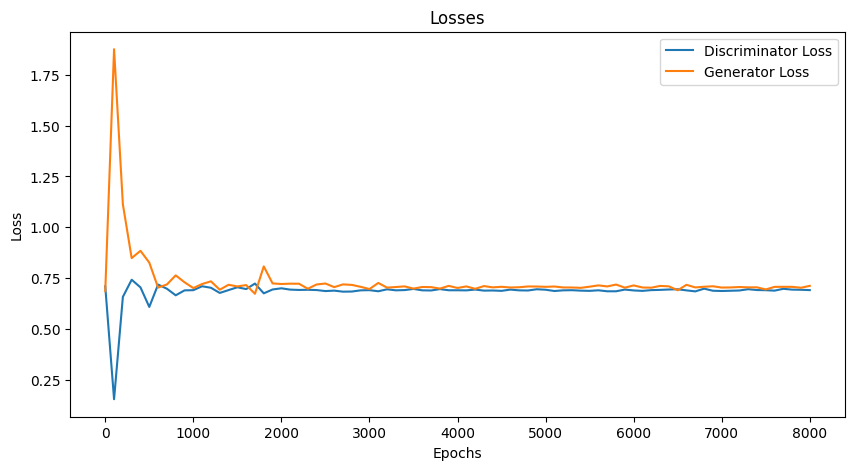

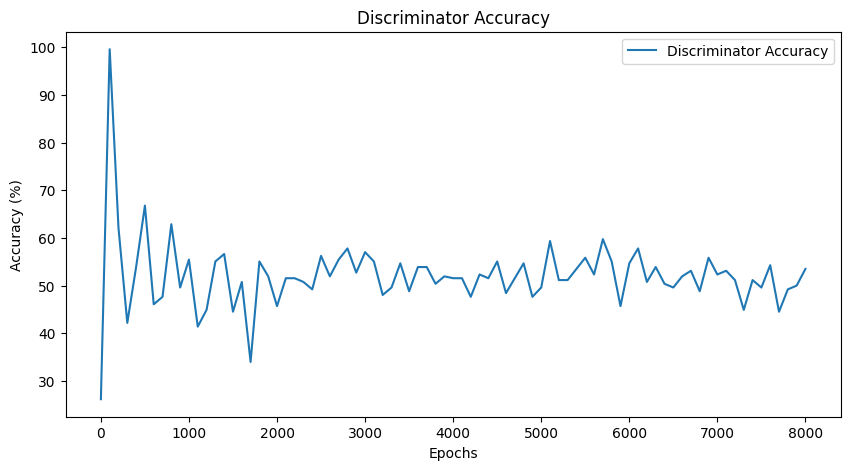

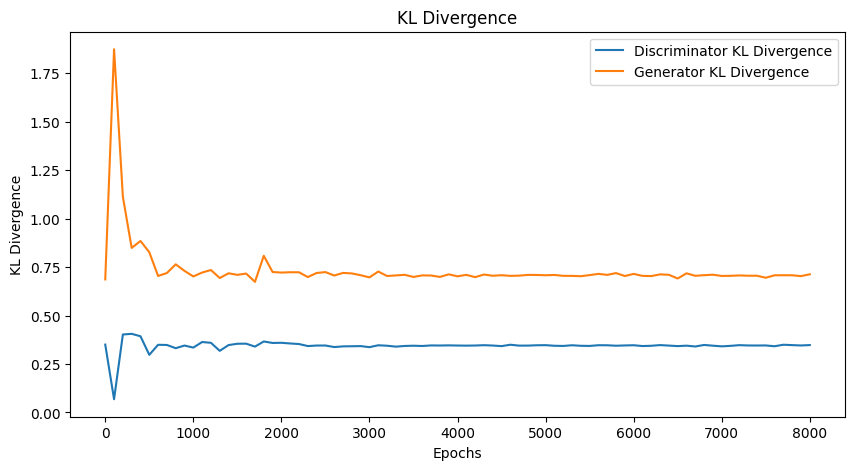

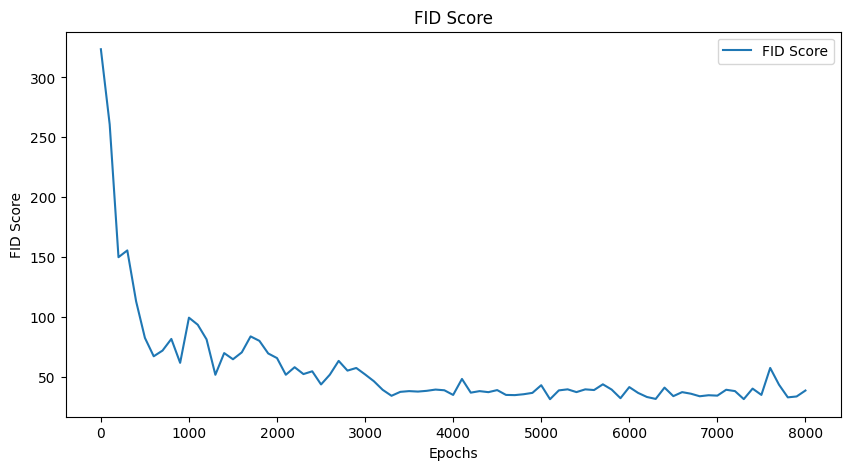

In [79]:
# Instantiate and train the DCGAN model
dcgan = DCGAN(28, 28, 1)
dcgan.train(balanced_X, epochs=8001, batch_size=128, save_interval=100)

***
D loss (Discriminator Loss): 
- At 0.6919, this is a bit higher than your previous value, indicating the discriminator is finding it harder to differentiate between real and generated images. You may need to adjust the discriminator’s architecture or training process to improve this.

G loss (Generator Loss): 
- At 0.7130, this is relatively low, suggesting the generator is performing reasonably well at fooling the discriminator. However, it's still essential to monitor whether this is improving the quality of generated images.

D accuracy: 
- At 53.52%, this indicates the discriminator’s accuracy is close to chance level, meaning it is struggling to distinguish between real and generated images. This might suggest that the generator is producing images that are increasingly convincing or that the discriminator is not learning effectively.

D KL Divergence: 
- At 0.3476, this is slightly higher than before, indicating there is a noticeable divergence between the real and generated image distributions from the perspective of the discriminator.

G KL Divergence: 
- At 0.7130, this is the same as the generator loss, reflecting the divergence between the generator's output and the target distribution. This suggests the generator's output is somewhat consistent with its loss value.

FID (Fréchet Inception Distance): 
- At 38.71, this is very close to your previous FID score. It indicates that the quality and diversity of generated images are similar to the previous set of results. The slight change might not be significant but suggests consistency in performance.

Summary:

>This set of metrics suggests that the generator might be producing more convincing images (as indicated by the lower generator loss and discriminator accuracy close to chance) but could benefit from further tuning of both the generator and discriminator to improve image quality and discriminator performance.
***

### Visually inspect the images

C:\Users\caleb\AppData\Local\Temp\ipykernel_24636\38160720.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  frames.append(imageio.imread(img_path))


GIF saved at generated_DCGAN_progression.gif


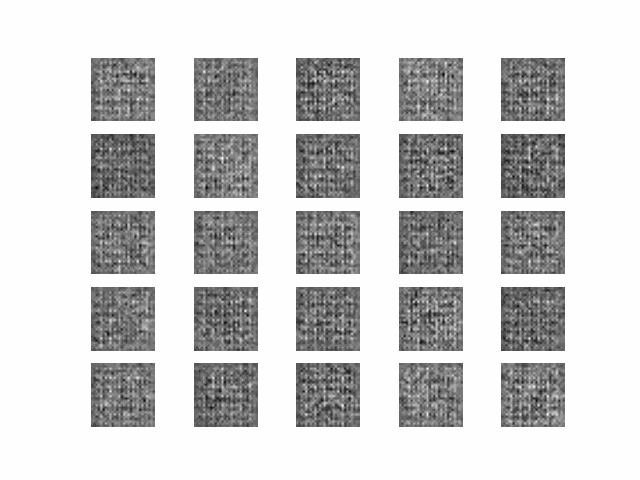

In [25]:
# Create GIF after training
create_gif('generated_DCGAN', 'generated_DCGAN_progression.gif')

# Path to the GIF file
gif_path = 'generated_DCGAN_progression.gif'

# Display the GIF
display(Image(filename=gif_path))

***
If GIF does not work you can view it in the folder with the name of the GIF file above.
***

### CGAN Model
Conditional GANs (cGANs) are an extension of the basic GAN (Generative Adversarial Network) framework that allows for generating images conditioned on additional information. This additional information can be any form of auxiliary data, such as class labels, text, or other types of structured data.

**Why did we choose to train this model:**
- Class-Conditional Generation: 
    - cGANs can generate images of specific classes within the EMNIST dataset (e.g., specific handwritten letters). This is useful if you need to generate samples of particular characters or digits. We would be making use of this later on to generate class specfic letters.
- Improved Quality and Relevance: 
    - By conditioning on additional information, cGANs can produce more relevant and higher-quality outputs compared to standard GANs.
- Versatility: 
    - Since EMNIST includes various types of handwritten characters, DCGANs can help explore different classes by generating samples for each class.
- Controlled Generation: 
    - cGANs allow for more controlled generation of data by conditioning the output on specific information. This is useful for generating data of particular classes or with particular attributes.

**Weakness**
- Resource Intensive:
    - Training cGANs can be computationally demanding, requiring significant resources in terms of time and hardware, especially for large and complex datasets.
- Balancing Generator and Discriminator:
    - The conditioning information needs to be balanced carefully between the generator and discriminator to ensure effective learning.    
- Complexity and Training Stability:
    - Adding conditioning information increases the complexity of the model, which can make training even more challenging and unstable.

In [80]:
def kl_divergence(y_true, y_pred):
    y_true = K.clip(y_true, K.epsilon(), 1)
    y_pred = K.clip(y_pred, K.epsilon(), 1)
    return K.sum(y_true * K.log(y_true / y_pred), axis=-1)

class CGAN:
    def __init__(self, rows, cols, channels, num_classes, z=100):
        self.img_rows = rows
        self.img_cols = cols
        self.channels = channels
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = z
        self.num_classes = num_classes

        optimizer = Adam(learning_rate=0.0002, beta_1=0.5)

        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy', kl_divergence])

        self.generator = self.build_generator()

        z = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,), dtype='int32')
        img = self.generator([z, label])

        self.discriminator.trainable = False
        valid = self.discriminator([img, label])

        self.combined = Model([z, label], valid)
        self.combined.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=[kl_divergence])

    def build_generator(self):
        noise = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,), dtype='int32')

        label_embedding = Embedding(self.num_classes, self.latent_dim)(label)
        label_embedding = Flatten()(label_embedding)
        model_input = Concatenate()([noise, label_embedding])

        model = Sequential(name='Generator')
        model.add(Dense(128 * 7 * 7, activation="relu", input_dim=self.latent_dim + self.latent_dim))
        model.add(Reshape((7, 7, 128)))
        model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2D(self.channels, kernel_size=7, padding="same", activation='tanh'))

        model.summary()

        img = model(model_input)
        return Model([noise, label], img)

    def build_discriminator(self):
        img = Input(shape=self.img_shape)
        label = Input(shape=(1,), dtype='int32')

        label_embedding = Embedding(self.num_classes, np.prod(self.img_shape))(label)
        label_embedding = Flatten()(label_embedding)
        label_embedding = Dense(np.prod(self.img_shape))(label_embedding)
        label_embedding = Reshape(self.img_shape)(label_embedding)

        model = Sequential(name='Discriminator')
        model.add(Conv2D(128, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Conv2D(128, kernel_size=3, strides=2, padding="same"))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Flatten())
        model.add(Dense(128))
        
        img_features = model(img)
        label_embedding = Flatten()(label_embedding)
        label_embedding = Dense(128)(label_embedding)
        
        model_input = Concatenate()([img_features, label_embedding])
        validity = Dense(1, activation='sigmoid')(model_input)

        model.summary()

        return Model([img, label], validity)

    def calculate_fid(self, real_images, generated_images):
        def preprocess_images(images):
            images_resized = np.array([resize(image, (75, 75, self.channels), mode='reflect') for image in images])
            if images_resized.shape[-1] == 1:
                images_resized = np.concatenate([images_resized] * 3, axis=-1)
            return images_resized

        def get_activations(images):
            model = InceptionV3(include_top=False, pooling='avg', input_shape=(75, 75, 3))
            images = preprocess_input(images)
            return model.predict(images)

        real_images_rgb = preprocess_images(real_images)
        generated_images_rgb = preprocess_images(generated_images)

        real_activations = get_activations(real_images_rgb)
        generated_activations = get_activations(generated_images_rgb)

        mu_real, sigma_real = real_activations.mean(axis=0), np.cov(real_activations, rowvar=False)
        mu_gen, sigma_gen = generated_activations.mean(axis=0), np.cov(generated_activations, rowvar=False)

        ssdiff = np.sum((mu_real - mu_gen) ** 2.0)
        sqrt_sigma = sqrtm(sigma_real.dot(sigma_gen))
        if np.iscomplexobj(sqrt_sigma):
            sqrt_sigma = sqrt_sigma.real
        fid = ssdiff + np.trace(sigma_real + sigma_gen - 2.0 * sqrt_sigma)

        return fid

    def train(self, balanced_X, balanced_y, epochs, batch_size=128, save_interval=50):
        X_train = balanced_X
        y_train = balanced_y

        X_train = X_train.reshape(-1, self.img_rows, self.img_cols, self.channels)

        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))

        d_losses = []
        g_losses = []
        d_accuracies = []
        kl_divergences_d = []
        kl_divergences_g = []
        fid_scores = []

        for epoch in range(epochs):
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]
            labels = y_train[idx]

            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_labels = np.random.randint(0, self.num_classes, batch_size).reshape(-1, 1)
            gen_imgs = self.generator.predict([noise, gen_labels])

            d_loss_real = self.discriminator.train_on_batch([imgs, labels], valid)
            d_loss_fake = self.discriminator.train_on_batch([gen_imgs, gen_labels], fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            g_loss = self.combined.train_on_batch([noise, gen_labels], valid)

            if epoch % save_interval == 0:
                fid_score = self.calculate_fid(imgs, gen_imgs)
                fid_scores.append(fid_score)

            print ("%d [D loss: %f, acc.: %.2f%%, KL div.: %f] [G loss: %f, KL div.: %f, FID: %f]" % (
                epoch, d_loss[0], 100 * d_loss[1], d_loss[2], g_loss[0], g_loss[1], fid_score if epoch % save_interval == 0 else 0))

            if epoch % save_interval == 0:
                self.save_imgs(epoch)
                d_losses.append(d_loss[0])
                g_losses.append(g_loss[0])
                d_accuracies.append(100 * d_loss[1])
                kl_divergences_d.append(d_loss[2])
                kl_divergences_g.append(g_loss[1])

        self.print_final_metrics(d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores)
        self.plot_losses(d_losses, g_losses, save_interval)
        self.plot_accuracy(d_accuracies, save_interval)
        self.plot_kl_divergence(kl_divergences_d, kl_divergences_g, save_interval)
        self.plot_fid(fid_scores, save_interval)

    def save_imgs(self, epoch):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_labels = np.arange(0, r * c) % self.num_classes
        gen_imgs = self.generator.predict([noise, gen_labels])

        if self.channels == 1:
            gen_imgs = np.expand_dims(gen_imgs, axis=-1)
        
        gen_imgs_resized = np.array([resize(img, (75, 75, self.channels), mode='reflect') for img in gen_imgs])

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i, j].imshow(gen_imgs_resized[cnt, :, :, 0], cmap='gray' if self.channels == 1 else 'auto')
                axs[i, j].axis('off')
                cnt += 1
        os.makedirs('generated_CGAN', exist_ok=True)
        fig.savefig("generated_CGAN/CGAN_mnist_{:d}.png".format(epoch))
        plt.close()

    def print_final_metrics(self, d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores):
        print("\nFinal metrics:")
        print(f"Final D loss: {d_losses[-1] if d_losses else 'No data'}")
        print(f"Final G loss: {g_losses[-1] if g_losses else 'No data'}")
        print(f"Final D accuracy: {d_accuracies[-1] if d_accuracies else 'No data'}%")
        print(f"Final D KL Divergence: {kl_divergences_d[-1] if kl_divergences_d else 'No data'}")
        print(f"Final G KL Divergence: {kl_divergences_g[-1] if kl_divergences_g else 'No data'}")
        print(f"Final FID: {fid_scores[-1] if fid_scores else 'No data'}")

    def plot_losses(self, d_losses, g_losses, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(d_losses) * save_interval, save_interval), d_losses, label='Discriminator Loss')
        plt.plot(range(0, len(g_losses) * save_interval, save_interval), g_losses, label='Generator Loss')
        plt.title('Losses')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
        plt.show()

    def plot_accuracy(self, d_accuracies, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(d_accuracies) * save_interval, save_interval), d_accuracies, label='Discriminator Accuracy')
        plt.title('Discriminator Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy (%)')
        plt.legend()
        plt.show()

    def plot_kl_divergence(self, kl_divergences_d, kl_divergences_g, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(kl_divergences_d) * save_interval, save_interval), kl_divergences_d, label='Discriminator KL Divergence')
        plt.plot(range(0, len(kl_divergences_g) * save_interval, save_interval), kl_divergences_g, label='Generator KL Divergence')
        plt.title('KL Divergence')
        plt.xlabel('Epoch')
        plt.ylabel('KL Divergence')
        plt.legend()
        plt.show()

    def plot_fid(self, fid_scores, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(fid_scores) * save_interval, save_interval), fid_scores, label='FID Score')
        plt.title('FID Score')
        plt.xlabel('Epoch')
        plt.ylabel('FID Score')
        plt.legend()
        plt.show()

### Running the CGAN Model

Model: "Discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9330 (Conv2D)        (None, 14, 14, 128)       1280      
                                                                 
 leaky_re_lu_28 (LeakyReLU)  (None, 14, 14, 128)       0         
                                                                 
 dropout_14 (Dropout)        (None, 14, 14, 128)       0         
                                                                 
 conv2d_9331 (Conv2D)        (None, 7, 7, 128)         147584    
                                                                 
 leaky_re_lu_29 (LeakyReLU)  (None, 7, 7, 128)         0         
                                                                 
 dropout_15 (Dropout)        (None, 7, 7, 128)         0         
                                                                 
 flatten_11 (Flatten)        (None, 6272)            

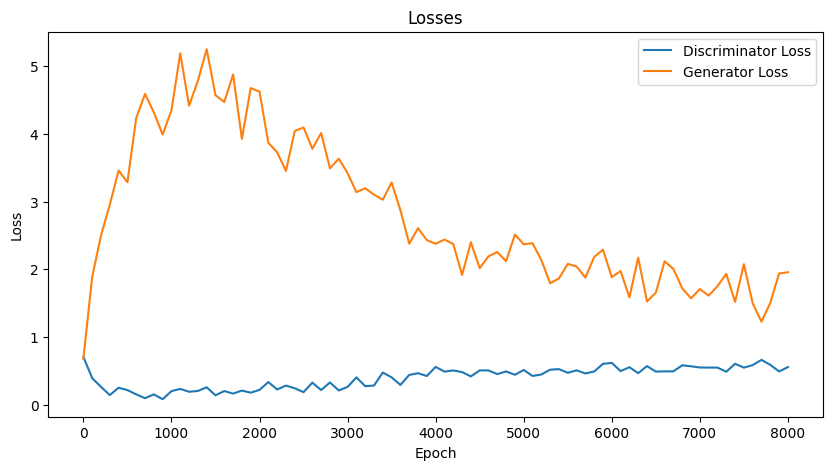

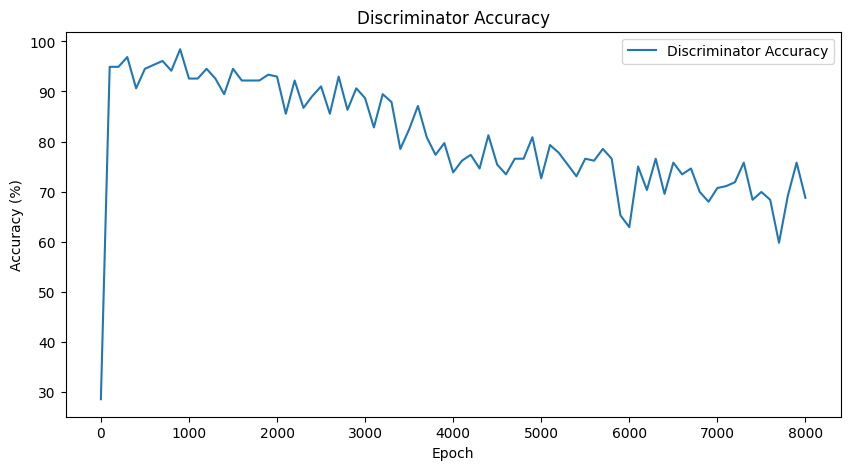

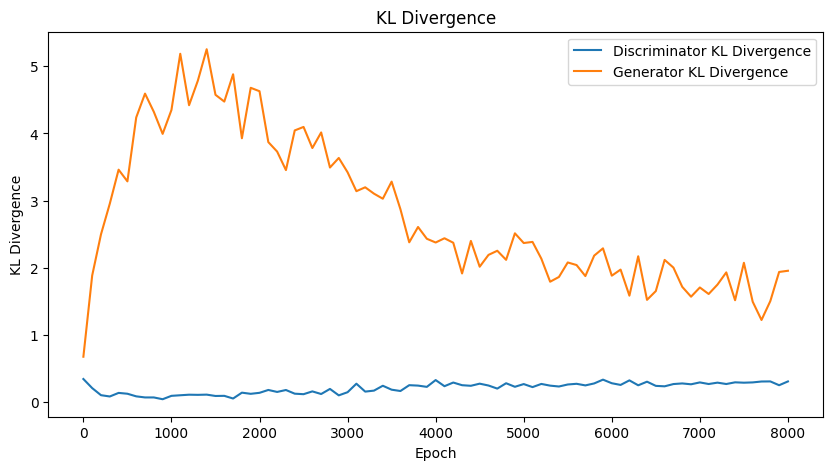

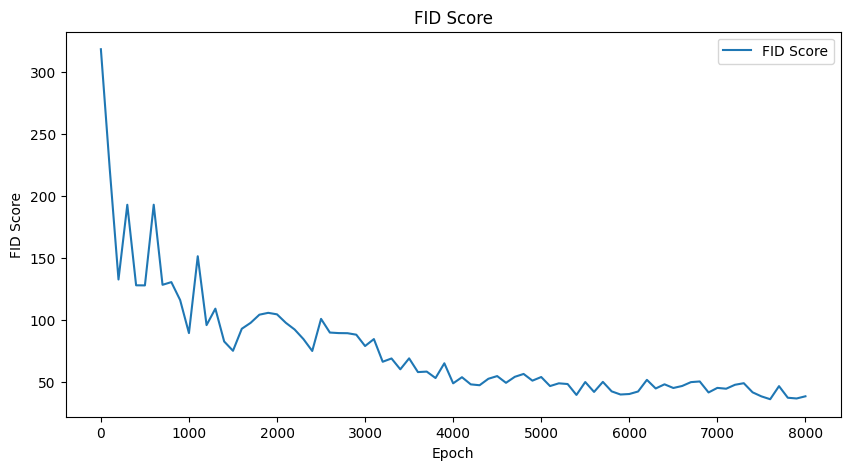

In [81]:
# Instantiate and train the CGAN model
cgan = CGAN(28, 28, 1, num_classes=26, z=100)
cgan.train(balanced_X, balanced_y, epochs=8001, batch_size=128, save_interval=100)

***
D loss (Discriminator Loss): 
- At 0.5547, this value suggests the discriminator is still learning but has some room for improvement. A lower value generally indicates the discriminator is distinguishing between real and generated images better.

G loss (Generator Loss): 
- At 1.9567, this is relatively high. The generator might need more tuning to produce images that the discriminator finds more convincing.

D accuracy: 
- At 68.75%, this indicates the discriminator is correctly classifying real vs. generated images about 69% of the time. This is a decent start, but you might aim to increase this accuracy further.

D KL Divergence:
- At 0.3103, this measures the divergence between the true distribution of real images and the distribution the discriminator is learning to classify. Lower values are better, but the context of the divergence depends on the distribution and training dynamics.

G KL Divergence: 
- At 1.9567, this value reflects the divergence between the generator's output and the target distribution. The higher value suggests that there is still a noticeable difference between generated and target images.

FID (Fréchet Inception Distance): 
- At 38.67, this measures the similarity between generated images and real images. Lower FID scores are better, indicating that the generated images are closer to the real images in terms of quality and diversity. Your FID score suggests there’s room for improvement in image quality.

Summary:
> These metrics suggest that while the discriminator is performing well, the generator is still facing challenges. The high generator loss and FID score suggest that the quality and diversity of the generated images could be improved.
***

### Visually inspect the images

C:\Users\caleb\AppData\Local\Temp\ipykernel_24636\38160720.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  frames.append(imageio.imread(img_path))


GIF saved at generated_CGAN_progression.gif


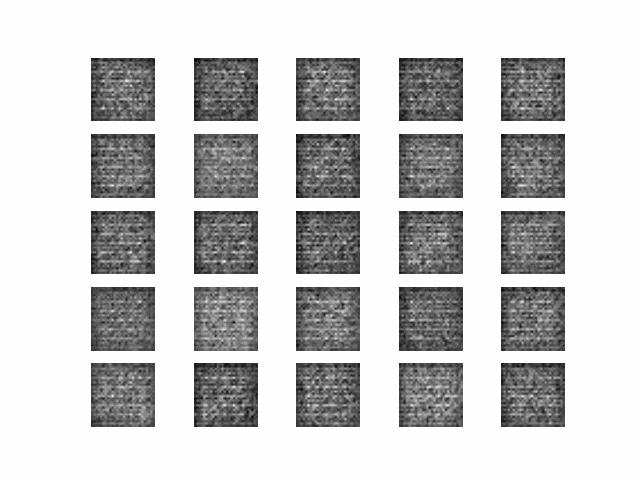

In [26]:
# Create GIF after training
create_gif('generated_CGAN', 'generated_CGAN_progression.gif')

# Path to the GIF file
gif_path = 'generated_CGAN_progression.gif'

# Display the GIF
display(Image(filename=gif_path))

***
If GIF does not work you can view it in the folder with the name of the GIF file above.
***

## Model Improvement
***

### Label Smoothing (Improving Discriminator)

**What is this:**
- Label smoothing is a regularization technique used in machine learning to improve the training of Generative Adversarial Networks (GANs). It involves modifying the target labels to be less certain, which can help models generalize better and reduce overfitting.

**How it works:**
- Instead of using hard labels (e.g., 1 for true class and 0 for false classes), label smoothing modifies the target labels to be softer. For instance, instead of having a label of 1 for the true class and 0 for others, label smoothing might use 0.9 for the true class and 0.1 (or lower) for the others.

**Why did we use this:**
- Prevent Overfitting: 
    - Helps the discriminator generalize better by not overfitting to the real examples.
- Balanced Training: 
    - Keeps the discriminator's predictions less certain, which can lead to a more balanced and stable adversarial training process.

- Improving Generalization: 
    - For character recognition models, label smoothing can help improve generalization by preventing the model from becoming too confident in its predictions. This is useful for reducing overfitting, especially when working with a complex dataset like EMNIST.

- Enhancing GAN Training: 
    - GANs for generating handwritten characters from the EMNIST dataset, label smoothing can improve the stability and quality of the generated images by preventing the discriminator from overpowering the generator.

> In this case, we did label smoothing to be applied to the discriminator to prevent it from becoming too confident and to improve the stability of the training process. This helps to prevent overfitting and helps the discriminator generalize better by not overfitting to the real examples.
It also balances training, keepsing the discriminator's predictions less certain, which can lead to a more balanced and stable adversarial training process.
***

### Feature Matching (Improving Generator)

**What is this:**
- Feature Matching is a technique used in GANs (Generative Adversarial Networks) to stabilize the training process and improve the quality of generated samples. It helps in addressing some of the training challenges by modifying the loss function used for training the generator.

- Instead of just minimizing the discrepancy between the generated images and the real images in terms of pixel-wise differences or probabilities, feature matching focuses on matching the statistical features (e.g., activations) extracted by the discriminator from real and generated images.

**How it works:**
- Feature Extraction: 
    - The discriminator network is used to extract intermediate features (activation maps) from both real and generated images.
- Feature Matching Loss:
    - The generator is trained to minimize the difference between the feature statistics of the generated images and those of the real images. This is done by comparing the mean and variance of features extracted from both types of images.
- Loss Function: 
    - The generator loss is defined based on the difference between the statistics (e.g., mean and variance) of features for real and generated images, rather than just using the discriminator's binary classification output.


**Why did we use this:**
- Stabilizing Training: 
    - EMNIST, with its complexity and variety of characters, can benefit from the stability that feature matching provides, especially if you encounter issues like mode collapse.
- Improving Sample Quality:
    - Feature matching can improve the quality of generated handwritten characters by ensuring that the generated samples closely match the feature distributions of real characters.
- Handling Variations:
    - Since EMNIST includes a diverse range of handwritten characters, feature matching can help the generator produce more diverse and realistic samples by focusing on feature-level consistency.

> In this case, we did feature matching to be applied to the generator to prevent it from modifies the generator’s loss function to focus on matching the feature statistics extracted by the discriminator, rather than just minimizing the adversarial loss. This helped the stability of GAN training and the quality of generated samples.

***

### Spectral Normalization (Improving both generator and discriminator)

**What is this:**
- Spectral Normalization is a technique used in the training of Generative Adversarial Networks (GANs) to stabilize the training process by controlling the spectral norm (or largest singular value) of weight matrices in the network.

- Addresses issues related to the training of GANs, such as instability and mode collapse, by ensuring that the network does not become too powerful.

**How it works:**
- Compute the Spectral Norm:
    - The spectral norm is computed using techniques like power iteration to approximate the largest singular value of the weight matrix.

- Normalize the Weights:
    - Divide the weight matrix by its spectral norm to ensure that the norm of the weights is controlled.

- Apply it during Training:
    - Spectral normalization is applied to weight matrices in layers like convolutional layers and fully connected layers, helping to stabilize the training of the discriminator and the generator in GANs.


**Why did we use this:**
1. Stabilizing Training
- *Discriminator:* Handwritten characters can be complex and diverse. Spectral normalization helps prevent the discriminator from becoming too powerful, which can lead to more stable training dynamics. This is crucial for ensuring that the discriminator does not overpower the generator, allowing for more effective learning.

- *Generator:* By stabilizing the discriminator, spectral normalization indirectly benefits the generator by providing more stable gradients. This helps in reducing issues like mode collapse, where the generator produces limited variations of characters.

2. Improving Quality of Generated Samples
- *Discriminator:* With a stable discriminator, the feedback it provides to the generator becomes more reliable. This leads to improved quality of generated handwritten characters, as the generator receives better signals on how to improve its outputs.
- *Generator:* Spectral normalization helps the generator produce more realistic and varied characters by ensuring that the generator’s network does not have excessively large weights, which can lead to better generalization and diversity in generated samples.

> In this case, we did Spectral Normalization to help in stabilizing the training of GANs and improving the quality of generated samples. For discriminator, we applied spectral normalization to convolutional and fully connected layers in the discriminator to control its capacity and ensure it does not become overly powerful. For generator, we applied spectral normalization to the generator’s layers (e.g., convolutional layers) to ensure that the generator's outputs are well-behaved and to stabilize training dynamics.

***

#### Spectral Normalization & Feature Matched & Label Smoothed DCGAN Model

In [10]:
class SpectralNormalization(tf.keras.layers.Wrapper):
    def __init__(self, layer, power_iterations=1, **kwargs):
        super(SpectralNormalization, self).__init__(layer, **kwargs)
        self.power_iterations = power_iterations

    def build(self, input_shape):
        self.layer.build(input_shape)
        self.w = self.layer.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer=tf.initializers.TruncatedNormal(stddev=0.02), trainable=False, name='sn_u')

    def call(self, inputs, training=None):
        self._compute_weights(training)
        output = self.layer(inputs)
        return output

    def _compute_weights(self, training):
        w_shape = self.w.shape.as_list()
        w = tf.reshape(self.w, [-1, w_shape[-1]])

        u_hat = self.u
        v_hat = None
        for _ in range(self.power_iterations):
            v_hat = tf.nn.l2_normalize(tf.matmul(u_hat, tf.transpose(w)))
            u_hat = tf.nn.l2_normalize(tf.matmul(v_hat, w))

        sigma = tf.matmul(tf.matmul(v_hat, w), tf.transpose(u_hat))
        self.u.assign(u_hat)
        self.layer.kernel.assign(self.w / sigma)

class SN_FM_LS_DCGAN:
    def __init__(self, rows, cols, channels, z=100, smooth=0.1):
        self.img_rows = rows
        self.img_cols = cols
        self.channels = channels
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = z
        self.smooth = smooth  # Smoothing factor

        optimizer = Adam(learning_rate=0.0002, beta_1=0.5)

        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy', self.kl_divergence])

        self.generator = self.build_generator()

        z = Input(shape=(self.latent_dim,))
        img = self.generator(z)

        self.discriminator.trainable = False
        valid, intermediate_output = self.discriminator(img)

        self.combined = Model(z, [valid, intermediate_output])
        self.combined.compile(loss=['binary_crossentropy', self.feature_matching_loss], optimizer=optimizer, metrics=[self.kl_divergence])

    def feature_matching_loss(self, y_true, y_pred):
        return K.mean(K.square(y_true - y_pred))

    def build_generator(self):
        model = Sequential(name='Generator')
        model.add(Dense(128 * 7 * 7, activation="relu", input_dim=self.latent_dim))
        model.add(Reshape((7, 7, 128)))
        model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2D(self.channels, kernel_size=7, padding="same", activation='sigmoid'))

        model.summary()

        noise = Input(shape=(self.latent_dim,))
        img = model(noise)
        return Model(noise, img)

    def build_discriminator(self):
        img = Input(shape=self.img_shape)

        x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=2, input_shape=self.img_shape, padding="same"))(img)
        x = LeakyReLU(alpha=0.2)(x)
        x = Dropout(0.4)(x)
        x = SpectralNormalization(Conv2D(128, kernel_size=3, strides=2, padding="same"))(x)
        x = LeakyReLU(alpha=0.2)(x)
        x = Dropout(0.4)(x)
        
        intermediate_output = Flatten()(x)
        
        validity = SpectralNormalization(Dense(1, activation='sigmoid'))(intermediate_output)

        model = Model(img, [validity, intermediate_output])
        model.summary()

        return model

    def kl_divergence(self, y_true, y_pred):
        y_true = K.clip(y_true, K.epsilon(), 1)
        y_pred = K.clip(y_pred, K.epsilon(), 1)
        return K.sum(y_true * K.log(y_true / y_pred), axis=-1)

    def calculate_fid(self, real_images, generated_images):
        real_images_resized = np.array([resize(img, (75, 75, img.shape[2]), anti_aliasing=True) for img in real_images])
        generated_images_resized = np.array([resize(img, (75, 75, img.shape[2]), anti_aliasing=True) for img in generated_images])

        if real_images_resized.shape[-1] == 1:
            real_images_rgb = np.repeat(real_images_resized, 3, axis=-1)
            generated_images_rgb = np.repeat(generated_images_resized, 3, axis=-1)
        else:
            real_images_rgb = real_images_resized
            generated_images_rgb = generated_images_resized

        model = InceptionV3(include_top=False, pooling='avg', input_shape=(75, 75, 3))
        
        real_images_rgb = preprocess_input(real_images_rgb)
        generated_images_rgb = preprocess_input(generated_images_rgb)
        
        real_activations = model.predict(real_images_rgb)
        generated_activations = model.predict(generated_images_rgb)

        mu_real, sigma_real = real_activations.mean(axis=0), np.cov(real_activations, rowvar=False)
        mu_gen, sigma_gen = generated_activations.mean(axis=0), np.cov(generated_activations, rowvar=False)

        ssdiff = np.sum((mu_real - mu_gen) ** 2.0)
        sqrt_sigma = sqrtm(sigma_real.dot(sigma_gen))
        if np.iscomplexobj(sqrt_sigma):
            sqrt_sigma = sqrt_sigma.real
        fid = ssdiff + np.trace(sigma_real + sigma_gen - 2.0 * sqrt_sigma)

        return fid

    def train(self, balanced_X, epochs, batch_size=128, save_interval=50):
        X_train = balanced_X
        X_train = X_train.reshape(-1, self.img_rows, self.img_cols, self.channels)

        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))
        smooth_valid = np.ones((batch_size, 1)) * (1 - self.smooth) + self.smooth
        smooth_fake = np.zeros((batch_size, 1)) + self.smooth

        d_losses = []
        g_losses = []
        d_accuracies = []
        kl_divergences_d = []
        kl_divergences_g = []
        fid_scores = []

        best_fid = float('inf')

        for epoch in range(epochs):
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]

            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.generator.predict(noise)

            real_features = self.discriminator.predict(imgs)[1]
            fake_features = self.discriminator.predict(gen_imgs)[1]

            d_loss_real = self.discriminator.train_on_batch(imgs, [smooth_valid, real_features])
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, [smooth_fake, fake_features])
            d_loss = 0.5 * np.add(d_loss_real[0], d_loss_fake[0])

            g_loss = self.combined.train_on_batch(noise, [valid, real_features])

            if epoch % save_interval == 0:
                fid_score = self.calculate_fid(imgs, gen_imgs)
                fid_scores.append(fid_score)
                if fid_score < best_fid:
                    best_fid = fid_score
                    self.generator.save_weights('best_DCGAN_generator_weights.h5')

            print("%d [D loss: %f, acc.: %.2f%%, KL div.: %f] [G loss: %f, KL div.: %f, FID: %f]" % (
                epoch, d_loss, 100 * d_loss_real[1], d_loss_real[2], g_loss[0], g_loss[1], fid_score if epoch % save_interval == 0 else 0))

            if epoch % save_interval == 0:
                self.save_imgs(epoch)
                d_losses.append(d_loss)
                g_losses.append(g_loss[0])
                d_accuracies.append(100 * d_loss_real[1])
                kl_divergences_d.append(d_loss_real[2])
                kl_divergences_g.append(g_loss[1])

        self.print_final_metrics(d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores)
        self.plot_losses(d_losses, g_losses, save_interval)
        self.plot_accuracy(d_accuracies, save_interval)
        self.plot_kl_divergence(kl_divergences_d, kl_divergences_g, save_interval)
        self.plot_fid(fid_scores, save_interval)

    def save_imgs(self, epoch):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.generator.predict(noise)

        gen_imgs_resized = np.array([resize(img, (75, 75, img.shape[2]), anti_aliasing=True) for img in gen_imgs])

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i, j].imshow(gen_imgs_resized[cnt, :, :, 0], cmap='gray')
                axs[i, j].axis('off')
                cnt += 1
        os.makedirs('generated_SN_FM_LS_DCGAN', exist_ok=True)
        fig.savefig("generated_SN_FM_LS_DCGAN/SN_FM_LS_DCGAN_mnist_{:d}.png".format(epoch))
        plt.close()

    def print_final_metrics(self, d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores):
        print("Final D loss: {:.6f}".format(np.mean(d_losses)))
        print("Final G loss: {:.6f}".format(np.mean(g_losses)))
        print("Final D accuracy: {:.6f}%".format(np.mean(d_accuracies)))
        print("Final D KL Divergence: {:.6f}".format(np.mean(kl_divergences_d)))
        print("Final G KL Divergence: {:.6f}".format(np.mean(kl_divergences_g)))
        print("Final FID: {:.6f}".format(np.mean(fid_scores)))

    def plot_losses(self, d_losses, g_losses, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(d_losses) * save_interval, save_interval), d_losses, label="Discriminator Loss")
        plt.plot(range(0, len(g_losses) * save_interval, save_interval), g_losses, label="Generator Loss")
        plt.title("Losses")
        plt.xlabel("Epoch")
        plt.ylabel("Loss")
        plt.legend()
        plt.show()

    def plot_accuracy(self, d_accuracies, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(d_accuracies) * save_interval, save_interval), d_accuracies, label="Discriminator Accuracy")
        plt.title("Discriminator Accuracy")
        plt.xlabel("Epoch")
        plt.ylabel("Accuracy")
        plt.legend()
        plt.show()

    def plot_kl_divergence(self, kl_divergences_d, kl_divergences_g, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(kl_divergences_d) * save_interval, save_interval), kl_divergences_d, label="Discriminator KL Divergence")
        plt.plot(range(0, len(kl_divergences_g) * save_interval, save_interval), kl_divergences_g, label="Generator KL Divergence")
        plt.title("KL Divergence")
        plt.xlabel("Epoch")
        plt.ylabel("KL Divergence")
        plt.legend()
        plt.show()

    def plot_fid(self, fid_scores, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(fid_scores) * save_interval, save_interval), fid_scores, label="FID Score")
        plt.title("FID Score")
        plt.xlabel("Epoch")
        plt.ylabel("FID Score")
        plt.legend()
        plt.show()

#### Running the Spectral Normalization & Feature Matched & Label Smoothed DCGAN Model

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 spectral_normalization (Spe  (None, 14, 14, 128)      1408      
 ctralNormalization)                                             
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 14, 14, 128)       0         
                                                                 
 dropout (Dropout)           (None, 14, 14, 128)       0         
                                                                 
 spectral_normalization_1 (S  (None, 7, 7, 128)        147712    
 pectralNormalization)                                           
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 7, 7, 128)         0     

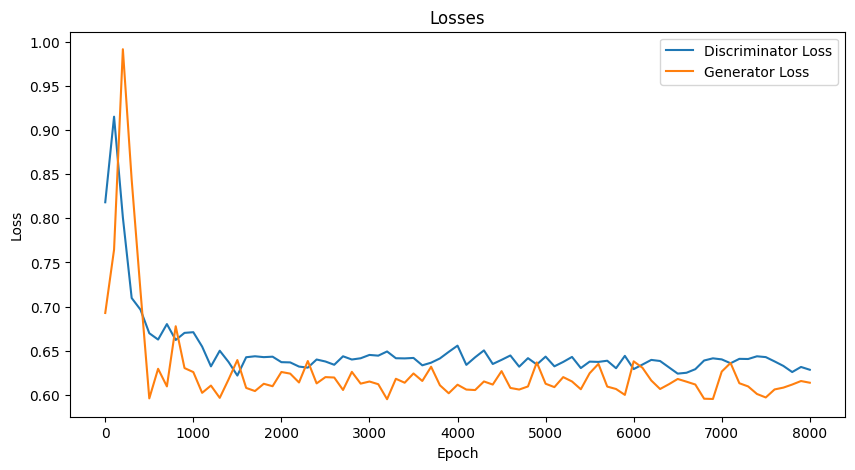

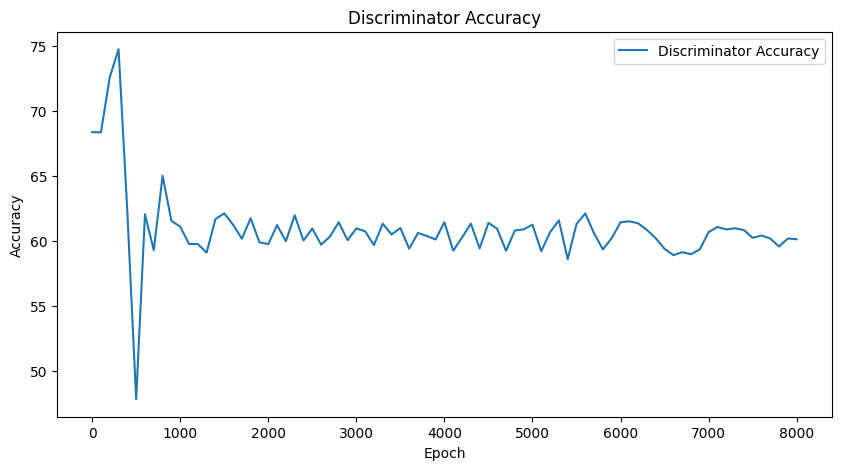

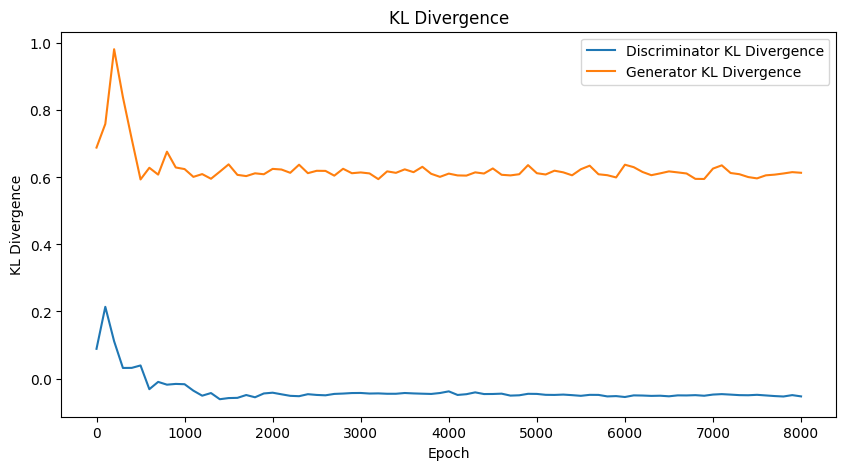

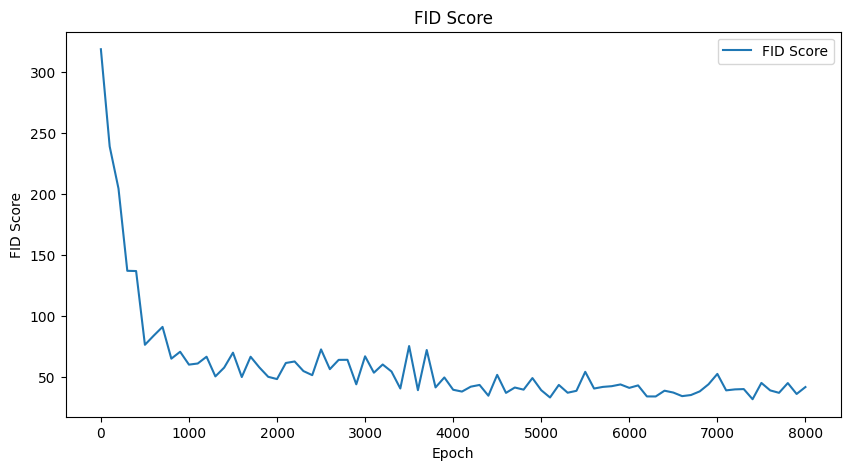

In [11]:
# Instantiate and train the DCGAN model
SN_FM_LS_DCGAN = SN_FM_LS_DCGAN(28, 28, 1)
SN_FM_LS_DCGAN.train(balanced_X, epochs=8001, batch_size=128, save_interval=100)

***
Base Metrics
- D loss: 0.6919
- G loss: 0.7130
- D accuracy: 53.52%
- D KL Divergence: 0.3476
- G KL Divergence: 0.7130
- FID: 38.71

Improved Metrics
- D loss: 0.6500
- G loss: 0.6270
- D accuracy: 60.94%
- D KL Divergence: 0.0367
- G KL Divergence: 0.6263
- FID: 59.05

Analysis
- Discriminator Loss: The improved D loss of 0.6500 is lower than the base value of 0.6919, indicating that the discriminator is learning better at distinguishing between real and generated images.

- Generator Loss: The improved G loss of 0.6270 is lower than the base value of 0.7130, suggesting that the generator is performing better at producing images that fool the discriminator.

- Discriminator Accuracy: The increased D accuracy of 60.94% (up from 53.52%) shows that the discriminator is more accurate in its classification, which generally reflects an improved learning process.

- Discriminator KL Divergence: The improved value of 0.0367 is unusual, as KL divergence is typically not so small. This might indicate an issue with numerical stability or computation.

- Generator KL Divergence: The improved G KL divergence of 0.6263 (down from 0.7130) is better, showing that the generator's output is closer to the target distribution.

- FID: The FID has increased from 38.71 to 59.05. An increase in FID suggests that the image quality or diversity of the generated images has decreased, which might be a result of changes in training dynamics or other factors.

Summary:

> The improved metrics show progress in some areas, particularly with reduced generator loss and improved discriminator accuracy. However, the increase in FID suggests that the overall quality of generated images may have worsened.
***

C:\Users\caleb\AppData\Local\Temp\ipykernel_24636\38160720.py:13: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  frames.append(imageio.imread(img_path))


GIF saved at generated_SN_FM_LS_DCGAN_progression.gif


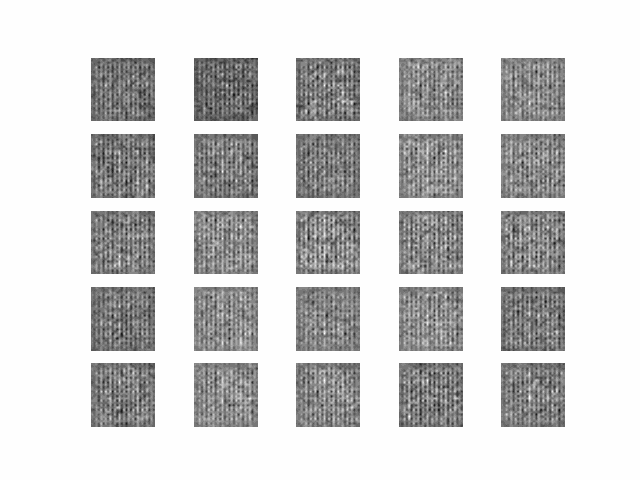

In [27]:
# Create GIF after training
create_gif('generated_SN_FM_LS_DCGAN', 'generated_SN_FM_LS_DCGAN_progression.gif')

# Path to the GIF file
gif_path = 'generated_SN_FM_LS_DCGAN_progression.gif'

# Display the GIF
display(Image(filename=gif_path))

***
If GIF does not work you can view it in the folder with the name of the GIF file above.
***

####  Spectral Normalization & Feature Matched & Label Smoothed CGAN Model

In [13]:
# Define the KL divergence metric
def kl_divergence(y_true, y_pred):
    y_true = tf.clip_by_value(y_true, tf.keras.backend.epsilon(), 1)
    y_pred = tf.clip_by_value(y_pred, tf.keras.backend.epsilon(), 1)
    return tf.reduce_sum(y_true * tf.math.log(y_true / y_pred), axis=-1)

# Define Spectral Normalization
class SpectralNormalization(tf.keras.layers.Wrapper):
    def __init__(self, layer, power_iterations=1, **kwargs):
        super(SpectralNormalization, self).__init__(layer, **kwargs)
        self.power_iterations = power_iterations

    def build(self, input_shape):
        self.layer.build(input_shape)
        self.w = self.layer.kernel
        self.u = self.add_weight(shape=(1, self.w.shape[-1]), initializer=tf.initializers.TruncatedNormal(stddev=0.02), trainable=False, name='sn_u')

    def call(self, inputs, training=None):
        self._compute_weights(training)
        output = self.layer(inputs)
        return output

    def _compute_weights(self, training):
        w_shape = self.w.shape.as_list()
        w = tf.reshape(self.w, [-1, w_shape[-1]])

        u_hat = self.u
        v_hat = None
        for _ in range(self.power_iterations):
            v_hat = tf.nn.l2_normalize(tf.matmul(u_hat, tf.transpose(w)))
            u_hat = tf.nn.l2_normalize(tf.matmul(v_hat, w))

        sigma = tf.matmul(tf.matmul(v_hat, w), tf.transpose(u_hat))
        self.u.assign(u_hat)
        self.layer.kernel.assign(self.w / sigma)

# SN_FM_LS_CGAN class
class SN_FM_LS_CGAN:
    def __init__(self, rows, cols, channels, num_classes, z=100, label_smooth=0.1):
        self.img_rows = rows
        self.img_cols = cols
        self.channels = channels
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = z
        self.num_classes = num_classes
        self.label_smooth = label_smooth

        optimizer = Adam(learning_rate=0.0002, beta_1=0.5)

        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss=self.smooth_loss, optimizer=optimizer, metrics=['accuracy', kl_divergence])

        self.generator = self.build_generator()

        z = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,), dtype='int32')
        img = self.generator([z, label])

        self.discriminator.trainable = False
        valid, features_real = self.discriminator([img, label])

        self.combined = Model([z, label], [valid, features_real])
        self.combined.compile(loss=['binary_crossentropy', 'mse'], optimizer=optimizer, metrics=[kl_divergence])

    def build_generator(self):
        noise = Input(shape=(self.latent_dim,))
        label = Input(shape=(1,), dtype='int32')

        label_embedding = Embedding(self.num_classes, self.latent_dim)(label)
        label_embedding = Flatten()(label_embedding)
        model_input = Concatenate()([noise, label_embedding])

        model = Sequential(name='Generator')
        model.add(Dense(128 * 7 * 7, activation="relu", input_dim=self.latent_dim + self.latent_dim))
        model.add(Reshape((7, 7, 128)))
        model.add(SpectralNormalization(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same')))
        model.add(LeakyReLU(alpha=0.2))
        model.add(SpectralNormalization(Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same')))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Conv2D(self.channels, kernel_size=7, padding="same", activation='tanh'))

        img = model(model_input)

        gen_model = Model([noise, label], img)
        gen_model.summary()
        return gen_model

    def build_discriminator(self):
        img = Input(shape=self.img_shape)
        label = Input(shape=(1,), dtype='int32')

        label_embedding = Embedding(self.num_classes, np.prod(self.img_shape))(label)
        label_embedding = Flatten()(label_embedding)
        label_embedding = Dense(np.prod(self.img_shape))(label_embedding)
        label_embedding = Reshape(self.img_shape)(label_embedding)

        model_input = Concatenate()([img, label_embedding])

        model = Sequential(name='Discriminator')
        model.add(SpectralNormalization(Conv2D(128, kernel_size=3, strides=2, input_shape=(self.img_rows, self.img_cols, self.channels * 2), padding="same")))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(SpectralNormalization(Conv2D(128, kernel_size=3, strides=2, padding="same")))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dropout(0.4))
        model.add(Flatten())

        img_features = model(model_input)

        validity = Dense(1, activation='sigmoid')(img_features)
        feature_output = Dense(128)(img_features)  # Adjust the dimension to match the required feature vector size

        disc_model = Model([img, label], [validity, feature_output])
        disc_model.summary()
        return disc_model

    def smooth_loss(self, y_true, y_pred):
        y_true = y_true * (1 - self.label_smooth) + self.label_smooth / 2
        return tf.keras.losses.binary_crossentropy(y_true, y_pred)

    def calculate_fid(self, real_images, generated_images):
        def preprocess_images(images):
            images_resized = np.array([resize(image, (75, 75, self.channels), mode='reflect') for image in images])
            if images_resized.shape[-1] == 1:
                images_resized = np.concatenate([images_resized] * 3, axis=-1)
            return images_resized

        def get_activations(images):
            model = InceptionV3(include_top=False, pooling='avg', input_shape=(75, 75, 3))
            images = preprocess_input(images)
            return model.predict(images)

        real_images_rgb = preprocess_images(real_images)
        generated_images_rgb = preprocess_images(generated_images)

        real_activations = get_activations(real_images_rgb)
        generated_activations = get_activations(generated_images_rgb)

        mu_real, sigma_real = real_activations.mean(axis=0), np.cov(real_activations, rowvar=False)
        mu_gen, sigma_gen = generated_activations.mean(axis=0), np.cov(generated_activations, rowvar=False)

        ssdiff = np.sum((mu_real - mu_gen) ** 2.0)
        sqrt_sigma = sqrtm(sigma_real.dot(sigma_gen))
        if np.iscomplexobj(sqrt_sigma):
            sqrt_sigma = sqrt_sigma.real
        fid = ssdiff + np.trace(sigma_real + sigma_gen - 2.0 * sqrt_sigma)

        return fid

    def train(self, balanced_X, balanced_y, epochs, batch_size=128, save_interval=50):
        X_train = balanced_X
        y_train = balanced_y

        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))

        d_losses = []
        g_losses = []
        d_accuracies = []
        kl_divergences_d = []
        kl_divergences_g = []
        fid_scores = []

        best_fid = float('inf')  # Initialize the best FID score as infinity

        for epoch in range(epochs):
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]
            labels = y_train[idx]

            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_labels = np.random.randint(0, self.num_classes, batch_size).reshape(-1, 1)
            gen_imgs = self.generator.predict([noise, gen_labels])

            d_loss_real = self.discriminator.train_on_batch([imgs, labels], [valid, np.zeros((batch_size, 128))])
            d_loss_fake = self.discriminator.train_on_batch([gen_imgs, gen_labels], [fake, np.zeros((batch_size, 128))])
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            features_real = self.discriminator.predict([imgs, labels])[1]
            features_fake = self.discriminator.predict([gen_imgs, gen_labels])[1]
            g_loss = self.combined.train_on_batch([noise, gen_labels], [valid, features_real])

            if epoch % save_interval == 0:
                fid_score = self.calculate_fid(imgs, gen_imgs)
                fid_scores.append(fid_score)

                if fid_score < best_fid:
                    best_fid = fid_score
                    self.generator.save_weights('best_CGAN_generator_weights.h5')

            print("%d [D loss: %f, acc.: %.2f%%, KL Divergence: %f] [G loss: %f, KL Divergence: %f, FID: %f]" %
                  (epoch, d_loss[0], 100*d_loss[1], d_loss[2], g_loss[0], g_loss[1], fid_scores[-1] if fid_scores else float('nan')))

            if epoch % save_interval == 0:
                self.save_imgs(epoch)
                d_losses.append(d_loss[0])
                g_losses.append(g_loss[0])
                d_accuracies.append(100 * d_loss[1])
                kl_divergences_d.append(d_loss[2])
                kl_divergences_g.append(g_loss[1])

        # Plot graphs after training completes
        self.plot_losses(d_losses, g_losses, save_interval)
        self.plot_accuracy(d_accuracies, save_interval)
        self.plot_kl_divergence(kl_divergences_d, kl_divergences_g, save_interval)
        self.plot_fid(fid_scores, save_interval)

        self.print_final_metrics(d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores)

    def save_imgs(self, epoch):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_labels = np.arange(1, r * c + 1) % self.num_classes  # Adjusted to start from class 1
        gen_labels[gen_labels == 0] = 1  # Ensure no class 0 labels

        gen_imgs = self.generator.predict([noise, gen_labels])

        if self.channels == 1:
            gen_imgs = np.squeeze(gen_imgs, axis=-1)

        fig, axs = plt.subplots(r, c)
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i, j].imshow(gen_imgs[cnt, :, :], cmap='gray' if self.channels == 1 else 'auto')
                axs[i, j].axis('off')
                cnt += 1
        os.makedirs('generated_SN_FM_LS_CGAN', exist_ok=True)
        fig.savefig(f"generated_SN_FM_LS_CGAN/SN_FM_LS_CGAN_mnist_{epoch}.png")
        plt.close()


    def print_final_metrics(self, d_losses, g_losses, d_accuracies, kl_divergences_d, kl_divergences_g, fid_scores):
        print(f"Final D loss: {d_losses[-1] if d_losses else float('nan')}")
        print(f"Final G loss: {g_losses[-1] if g_losses else float('nan')}")
        print(f"Final D accuracy: {d_accuracies[-1] if d_accuracies else float('nan')}%")
        print(f"Final D KL Divergence: {kl_divergences_d[-1] if kl_divergences_d else float('nan')}")
        print(f"Final G KL Divergence: {kl_divergences_g[-1] if kl_divergences_g else float('nan')}")
        print(f"Final FID: {fid_scores[-1] if fid_scores else float('nan')}")

    def plot_losses(self, d_losses, g_losses, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(d_losses) * save_interval, save_interval), d_losses, label='Discriminator loss')
        plt.plot(range(0, len(g_losses) * save_interval, save_interval), g_losses, label='Generator loss')
        plt.title('Discriminator and Generator Loss During Training')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.show()

    def plot_accuracy(self, d_accuracies, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(d_accuracies) * save_interval, save_interval), d_accuracies, label='Discriminator Accuracy')
        plt.title('Discriminator Accuracy During Training')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.legend()
        plt.show()

    def plot_kl_divergence(self, kl_divergences_d, kl_divergences_g, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(kl_divergences_d) * save_interval, save_interval), kl_divergences_d, label='Discriminator KL Divergence')
        plt.plot(range(0, len(kl_divergences_g) * save_interval, save_interval), kl_divergences_g, label='Generator KL Divergence')
        plt.title('Discriminator and Generator KL Divergence During Training')
        plt.xlabel('Epochs')
        plt.ylabel('KL Divergence')
        plt.legend()
        plt.show()

    def plot_fid(self, fid_scores, save_interval):
        plt.figure(figsize=(10, 5))
        plt.plot(range(0, len(fid_scores) * save_interval, save_interval), fid_scores, label='FID')
        plt.title('FID During Training')
        plt.xlabel('Epochs')
        plt.ylabel('FID Score')
        plt.legend()
        plt.show()

#### Running the Spectral Normalization & Feature Matched & Label Smoothed CGAN Model

Model: "model_12"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_169 (InputLayer)         [(None, 1)]          0           []                               
                                                                                                  
 embedding_8 (Embedding)        (None, 1, 784)       20384       ['input_169[0][0]']              
                                                                                                  
 flatten_12 (Flatten)           (None, 784)          0           ['embedding_8[0][0]']            
                                                                                                  
 dense_16 (Dense)               (None, 784)          615440      ['flatten_12[0][0]']             
                                                                                           

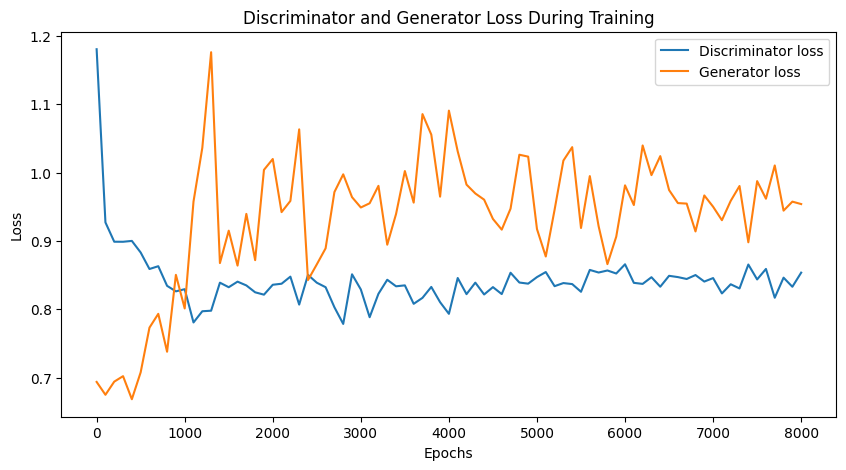

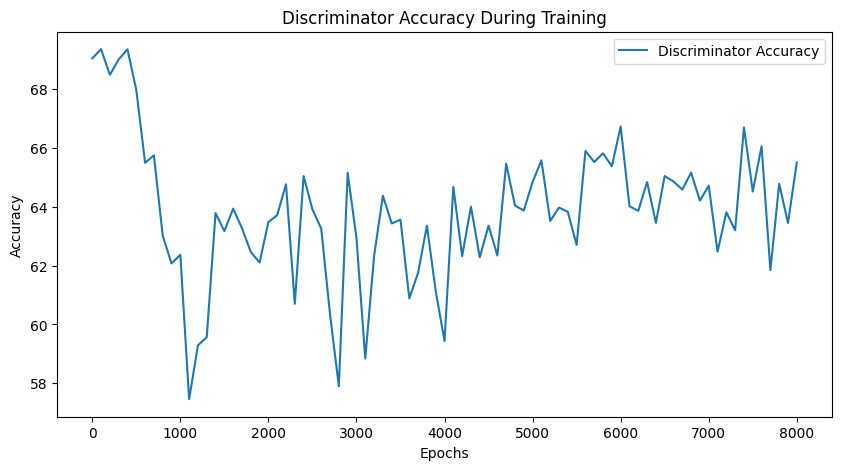

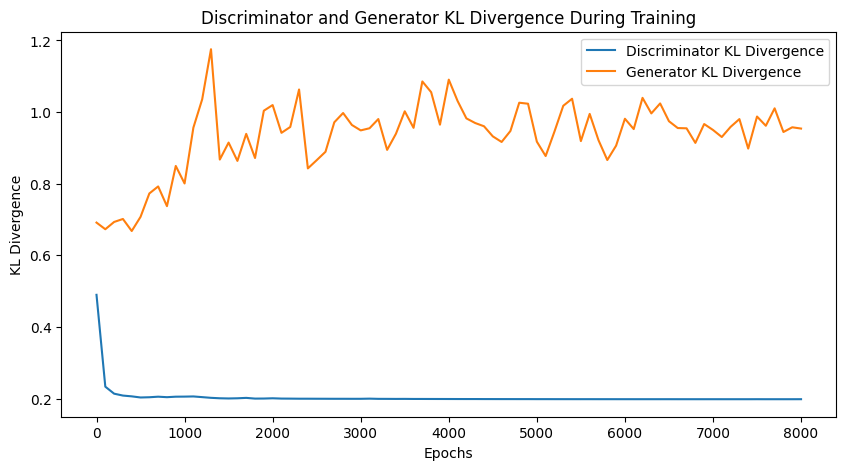

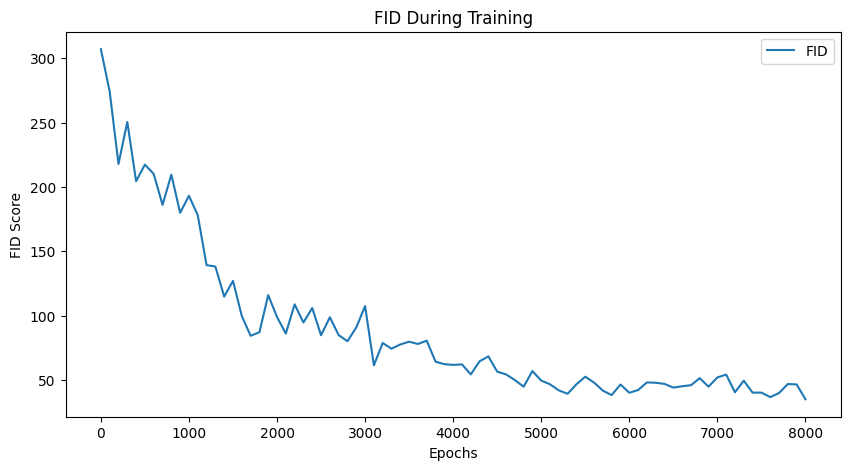

Final D loss: 0.8537251055240631
Final G loss: 0.9539953470230103
Final D accuracy: 65.51161408424377%
Final D KL Divergence: 0.19860897958278656
Final G KL Divergence: 0.953992486000061
Final FID: 34.963282400417135


In [31]:
# Instantiate and train the CGAN model
SN_FM_LS_cgan = SN_FM_LS_CGAN(28, 28, 1, num_classes=26, z=100, label_smooth=0.1)
SN_FM_LS_cgan.train(balanced_X, balanced_y, epochs=8001, batch_size=128, save_interval=100)

***
Before Training
- D loss: 0.5547
- G loss: 1.9567
- D accuracy: 68.75%
- D KL Divergence: 0.3103
- G KL Divergence: 1.9567
- FID: 38.67

After Training
- D loss: 0.8537
- G loss: 0.9540
- D accuracy: 65.51%
- D KL Divergence: 0.1986
- G KL Divergence: 0.9540
- FID: 34.96

Analysis:
- Discriminator Loss: The D loss has increased from 0.5547 to 0.8537. This increase suggests that the discriminator is finding it more challenging to distinguish between real and generated images after training, which could indicate that the generator's images are becoming more convincing.

- Generator Loss: The G loss has significantly decreased from 1.9567 to 0.9540, showing a substantial improvement in the generator’s performance. The generator is now better at producing images that can fool the discriminator.

- Discriminator Accuracy: The D accuracy has slightly decreased from 68.75% to 65.51%, which, in combination with the higher D loss, indicates that the discriminator is having a harder time distinguishing between real and generated images, implying improved performance of the generator.

- Discriminator KL Divergence: The D KL divergence has decreased from 0.3103 to 0.1986, suggesting that the discriminator's learned distribution is closer to the true distribution of real images.

- Generator KL Divergence: The G KL divergence has significantly decreased from 1.9567 to 0.9540, aligning with the generator loss, indicating that the generator's output distribution is much closer to the target distribution.

- FID (Fréchet Inception Distance): The FID has decreased from 38.67 to 34.96, showing an improvement in the quality and diversity of the generated images. Lower FID scores are better, and this decrease indicates that the images produced by the generator are closer to real images.

Summary:

> There is a noticeable improvement in the generator's performance, as evidenced by the reduced G loss, G KL divergence, and FID. Although the discriminator loss and accuracy have worsened, this is often expected as the generator improves. The overall improvements in the generator’s performance and the quality of the generated images are reflected in the lowered FID score. This indicates that my training process is effective in enhancing the generator's ability to produce realistic images.
***

### Visually inspect images for evalauation

C:\Users\caleb\AppData\Local\Temp\ipykernel_18652\1462898483.py:15: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  frames.append(imageio.imread(img_path))


GIF saved at generated_SN_FM_LS_CGAN_progression.gif


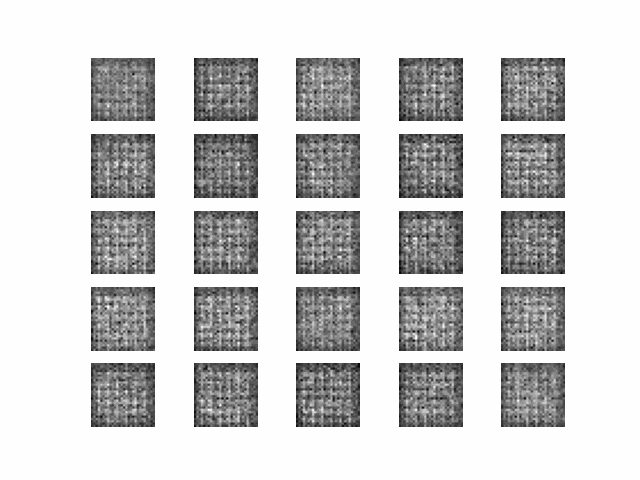

In [32]:
# Create GIF after training
create_gif('generated_SN_FM_LS_CGAN', 'generated_SN_FM_LS_CGAN_progression.gif')

# Path to the GIF file
gif_path = 'generated_SN_FM_LS_CGAN_progression.gif'

# Display the GIF
display(Image(filename=gif_path))

***
If GIF does not work you can view it in the folder with the name of the GIF file above.
***

## Checking image generation after Model Improvement

### Generate images of a specific class (Letter)

1/1 [==============================] - 0s 14ms/step


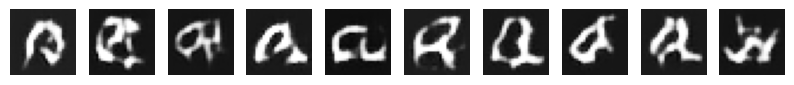

In [37]:
# Load the pre-trained generator weights
SN_FM_LS_cgan.generator.load_weights('best_CGAN_generator_weights.h5')

def generate_images(generator, latent_dim, num_classes, target_class, num_images=10):
    # Generate random noise
    noise = np.random.normal(0, 1, (num_images, latent_dim))
    
    # Create labels for the target class
    labels = np.full((num_images, 1), target_class)
    
    # Generate images
    generated_images = generator.predict([noise, labels])
    
    # Plot the generated images
    plt.figure(figsize=(10, 10))
    for i in range(num_images):
        plt.subplot(1, num_images, i + 1)
        plt.imshow(generated_images[i, :, :, 0], cmap='gray')
        plt.axis('off')
    plt.show()

# To generate images generate images of class 1 (Letter A)
generate_images(SN_FM_LS_cgan.generator, SN_FM_LS_cgan.latent_dim, SN_FM_LS_cgan.num_classes, target_class=1, num_images=10)

1/1 [==============================] - 0s 20ms/step


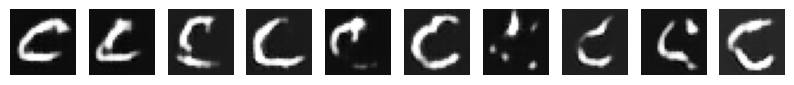

In [49]:
# To generate images generate images of class 3 (Letter C)
generate_images(SN_FM_LS_cgan.generator, SN_FM_LS_cgan.latent_dim, SN_FM_LS_cgan.num_classes, target_class=3, num_images=10)

1/1 [==============================] - 0s 15ms/step


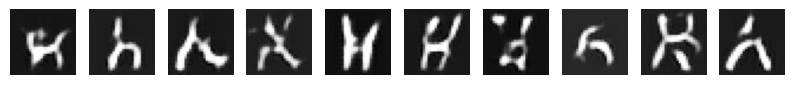

In [65]:
# To generate images of class 8 (Letter H)
generate_images(SN_FM_LS_cgan.generator, SN_FM_LS_cgan.latent_dim, SN_FM_LS_cgan.num_classes, target_class=8, num_images=10)

1/1 [==============================] - 0s 16ms/step


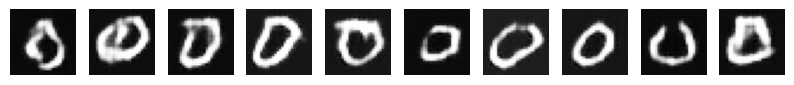

In [69]:
# To generate images of class 15 (Letter O)
generate_images(SN_FM_LS_cgan.generator, SN_FM_LS_cgan.latent_dim, SN_FM_LS_cgan.num_classes, target_class=15, num_images=10)

### Generating images of every class (Letter)

1/1 [==============================] - 0s 14ms/step


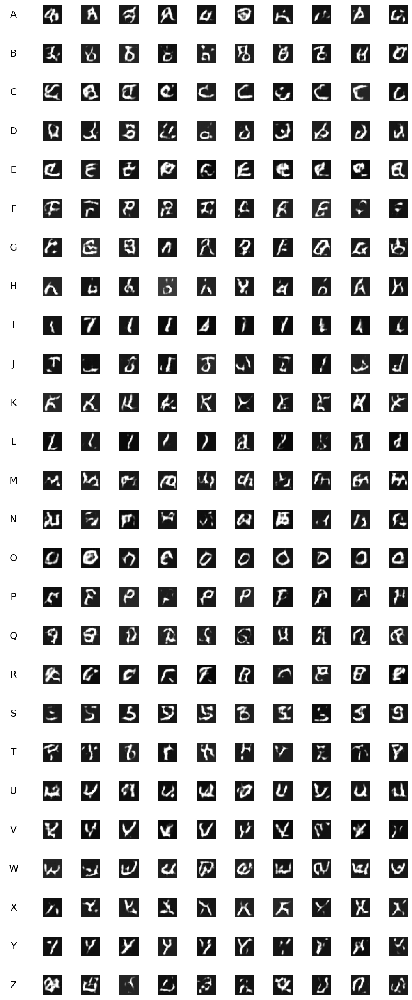

In [80]:
import os
import numpy as np
import matplotlib.pyplot as plt

def generate_images(generator, latent_dim, num_classes, num_images_per_class=10):
    # Create a directory to save the generated images
    os.makedirs('final_generated_images', exist_ok=True)
    
    all_images = []
    all_labels = []
    
    # Generate valid class labels
    valid_classes = list(range(1, num_classes))
    
    for target_class in valid_classes:
        # Generate random noise
        noise = np.random.normal(0, 1, (num_images_per_class, latent_dim))
        
        # Create labels for the target class
        labels = np.full((num_images_per_class, 1), target_class)
        
        # Generate images
        generated_images = generator.predict([noise, labels])
        
        # Collect all images and labels
        all_images.append(generated_images)
        all_labels.append(labels)
    
    # Concatenate all images and labels
    all_images = np.vstack(all_images)
    all_labels = np.vstack(all_labels).flatten()
    
    # Plot the generated images
    fig, axs = plt.subplots(len(valid_classes), num_images_per_class + 1, figsize=(num_images_per_class + 1, len(valid_classes)))
    fig.tight_layout(pad=1.0)
    
    for i, label in enumerate(valid_classes):
        # Label the first column with the alphabet starting from 'A'
        axs[i, 0].text(0.5, 0.5, chr(65 + (label - 1)), fontsize=18, ha='center', va='center')
        axs[i, 0].axis('off')
        for j in range(num_images_per_class):
            axs[i, j + 1].imshow(all_images[i * num_images_per_class + j, :, :, 0], cmap='gray')
            axs[i, j + 1].axis('off')
    
    # Save the final plot
    plt.savefig('final_generated_images/all_classes.png')
    plt.show()

# Generate 10 images for each class
generate_images(SN_FM_LS_cgan.generator, SN_FM_LS_cgan.latent_dim, 27, num_images_per_class=10)


## Conclusion
***

1. If you are asked to generate coloured images instead of black-and-white ones, do you
think it would be easier or harder to produce better quality results?

>Colored images would be harder to generate and produce better results than black-and-white images.

Colored Images has *increased complexity* such as:
- **Data Dimensions:** Colored images have three channels (RGB), whereas black-and-white images have just one channel. This means the generator and discriminator networks need to handle more complex data, which requires more capacity and potentially more training data.

Colored Images also face issues such as *higher variability* where:
- **Color Variations:** Colors add an additional layer of variability and complexity in how patterns and textures are represented. For instance, a slight change in color can drastically alter the perceived quality of an image.

Colored Images face also *training stability* issues:
- **Training Dynamics:** With more complex data, the training dynamics of GANs can become more unstable. Generating colored images might require more careful tuning of hyperparameters and network architectures.

In this case for the EMNIST dataset:
- EMNIST images are grayscale by default. Converting them to color (e.g., using RGB channels) would introduce complexity because you would need to generate color variations that make sense for handwritten characters. This might not add significant value because the natural color of handwritten letters is grayscale.
- The model complexity will increase as it needs to handle three color channels instead of one. This requires more sophisticated network architectures and potentially more training data.


2. What class(es) is/are relatively easier/harder to generate? Why?

>Classes that are harder to generate are those with similar looking characters or cause of the variablity of the writing styles.

In this case for the EMNIST dataset:
- Similar looking characters
    - Characters that are more similar in shape and structure (e.g. E & F, R & K) can be harder to generate accurately because the model needs to capture subtle distinctions. Furthermore, the EMNIST dataset contains both lower and upper case characters. This makes it even harder due to characters such as (e.g. lower case l and upper case I or lower case i) looking alike, or characters that are totally different from their lower case or upper case counterparts (e.g. D,d and E,e and R,r and G,g)
- Variations in handwriting styles
    - Differences in stroke thickness or character slant, can introduce additional complexity. People have different handwritings and writing styles. Characters such as lower case letter a has multiple ways that can be written.

> Classes that are easier to generate are those with distinct letters and consistent writing styles

- Distinct letters
    - Characters with more distinctive shapes might be easier to generate because they have clearer structural patterns. (e.g., 'A', 'Q') 
- Consistent writing styles
    - Characters that are more uniform in style and structure within the dataset will be easier for the model to learn and generate. Some examples are V,v and Z,z and X,x.

##